In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.signal import savgol_filter
import umap
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader
import torch.optim as optim

from torchvision.utils import make_grid

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [4]:
import os
os.chdir('../IConNet/')
os.getcwd()

'/home/linh/projects/IConNet'

In [5]:
os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "max_split_size_mb:512"
import gc
import sys
import numpy as np
from tqdm import tqdm

In [6]:
from IConNet.acov.audio_vqvae import VqVaeClsLoss
from IConNet.trainer.train_torch import get_dataloader
from IConNet.trainer.train_torch import Trainer_SCB10 as Trainer
from IConNet.acov.model import SCB7 as SCB
from omegaconf import OmegaConf as ocf

In [7]:
dataset_name = 'meld'
experiment_prefix = "scb7"
log_dir = f'../{experiment_prefix}_models/{dataset_name}/'
data_dir = "../data/data_preprocessed/"
dataset_config_path = f'config/dataset/{dataset_name}4.yaml'
dataset_config = ocf.load(dataset_config_path)
print(dataset_config)
batch_size = 2

{'name': 'meld', 'dataset_class': 'WaveformDataset', 'root': 'meld/', 'audio_dir': 'full_release/', 'feature_dir': 'features_4balanced/', 'label_name': 'label_emotion', 'feature_name': 'audio16k', 'num_classes': 4, 'label_values': [0, 1, 2, 3], 'classnames': ['neu', 'hap', 'sad', 'ang'], 'target_labels': ['ang', 'neu', 'sad', 'hap']}


In [8]:
train_loader, test_loader, batch_size = get_dataloader(
    dataset_config, data_dir, batch_size=batch_size)

In [9]:
loss_ratio=VqVaeClsLoss(perplexity=0, loss_vq=1, loss_recon=1, loss_cls=0.15)
trainer = Trainer(batch_size=batch_size, log_dir=log_dir, 
                  experiment_prefix=experiment_prefix, device=device,
                 accumulate_grad_batches=4)
trainer.prepare(train_loader=train_loader, 
                test_loader=test_loader, 
                batch_size=batch_size,
               loss_ratio=loss_ratio)

In [10]:
in_channels = 1
out_channels = 8
embedding_dim = 1023
num_embeddings = 384
commitment_cost = 0.25
learning_rate = 1e-4
num_tokens = 256
num_classes = 4

In [11]:
codebook_pretrained_path = f'../scb7_models/ravdess/codebook.step=10000.pt'
model = SCB(
    in_channels=in_channels,
    out_channels=out_channels,
    num_embeddings=num_embeddings, 
    embedding_dim=embedding_dim, 
    num_tokens=num_tokens,
    num_classes=num_classes, 
    cls_dim=embedding_dim,
    sample_rate=16000,
    commitment_cost=commitment_cost,
    distance_type='euclidean',
    codebook_pretrained_path=codebook_pretrained_path,
    freeze_codebook=False,
    loss_type='signal_loss',
)

In [12]:
trainer.setup(model=model, lr=learning_rate)

In [13]:
trainer.fit(
    n_epoch=100, lr=learning_rate, self_supervised=False, 
    train_task='embedding', test_n_epoch=10)

  0%|▎                                                                            | 0.47632390025215354/100 [09:32<1508:17:41, 54558.49s/it]

Epoch: 1	Loss: 7.570 [perplexity=8.172, loss_vq=7.092, loss_recon=0.227, loss_cls=1.673]	Val_acc: 198/340 (58.24%)

Saved new best val model: ../scb7_models/meld/model.epoch=1.step=1275.loss=7.570.val_acc=0.582.pt


  1%|▋                                                                             | 0.9523676099747226/100 [19:07<1492:01:25, 54229.32s/it]

Epoch: 1	Loss: 6.186 [perplexity=14.672, loss_vq=5.832, loss_recon=0.207, loss_cls=0.977]	Val_acc: 192/340 (56.47%)



  1%|█▏                                                                                | 1.4286915102270215/100 [26:30<25:53:24, 945.56s/it]

Correct: 927/1700 (0.5453)
Saved new best test model: ../scb7_models/meld/model.epoch=1.step=2549.test_acc=0.5453.pt
{'acc_unweighted': tensor(0.2718, device='cuda:0'),
 'acc_weighted': tensor(0.5453, device='cuda:0'),
 'f1s_unweighted': tensor(0.2237, device='cuda:0'),
 'f1s_weighted': tensor(0.4197, device='cuda:0'),
 'rocauc': tensor(0.5527, device='cuda:0'),
 'uar': tensor(0.2718, device='cuda:0'),
 'wap': tensor(0.4554, device='cuda:0')}
{'acc_detail': tensor([0.1323, 0.9520, 0.0000, 0.0029], device='cuda:0'),
 'f1s_detail': tensor([0.1789, 0.7102, 0.0000, 0.0058], device='cuda:0'),
 'precision_detail': tensor([0.2764, 0.5663, 0.0000, 0.5000], device='cuda:0'),
 'recall_detail': tensor([0.1323, 0.9520, 0.0000, 0.0029], device='cuda:0'),
 'rocauc_detail': tensor([0.6173, 0.5703, 0.5046, 0.5188], device='cuda:0')}
tensor([[ 34, 222,   0,   1],
        [ 45, 892,   0,   0],
        [ 13, 148,   0,   0],
        [ 31, 313,   0,   1]], device='cuda:0')


  2%|█▍                                                                            | 1.9050154104793393/100 [36:15<1475:23:30, 54145.59s/it]

Epoch: 2	Loss: 91.201 [perplexity=7.493, loss_vq=90.962, loss_recon=0.144, loss_cls=0.627]	Val_acc: 197/340 (57.94%)



  2%|█▊                                                                            | 2.3810591202020968/100 [45:55<1498:51:50, 55275.25s/it]

Epoch: 2	Loss: 49.400 [perplexity=3.909, loss_vq=49.035, loss_recon=0.268, loss_cls=0.645]	Val_acc: 197/340 (57.94%)



  3%|██▏                                                                           | 2.8573830204544146/100 [55:44<1482:23:48, 54936.01s/it]

Epoch: 3	Loss: 16.241 [perplexity=8.172, loss_vq=15.953, loss_recon=0.186, loss_cls=0.681]	Val_acc: 198/340 (58.24%)



  3%|██▌                                                                         | 3.3334267301771723/100 [1:05:30<1496:17:49, 55724.22s/it]

Epoch: 3	Loss: 8.770 [perplexity=6.830, loss_vq=8.340, loss_recon=0.201, loss_cls=1.524]	Val_acc: 193/340 (56.76%)



  4%|██▉                                                                           | 3.80975063042949/100 [1:15:23<1478:22:47, 55329.60s/it]

Epoch: 4	Loss: 35.070 [perplexity=8.172, loss_vq=34.715, loss_recon=0.185, loss_cls=1.130]	Val_acc: 197/340 (57.94%)



  4%|███▎                                                                         | 4.285794340152248/100 [1:25:11<1492:35:56, 56139.59s/it]

Epoch: 4	Loss: 16.344 [perplexity=7.493, loss_vq=16.058, loss_recon=0.128, loss_cls=1.053]	Val_acc: 193/340 (56.76%)



  5%|███▋                                                                         | 4.762118240404566/100 [1:35:03<1454:26:43, 54978.16s/it]

Epoch: 5	Loss: 16.487 [perplexity=11.314, loss_vq=16.060, loss_recon=0.223, loss_cls=1.363]	Val_acc: 205/340 (60.29%)

Saved new best val model: ../scb7_models/meld/model.epoch=5.step=11471.loss=16.487.val_acc=0.603.pt


  5%|████                                                                         | 5.238161950127323/100 [1:44:55<1493:49:47, 56750.56s/it]

Epoch: 5	Loss: 9.394 [perplexity=8.172, loss_vq=9.030, loss_recon=0.166, loss_cls=1.320]	Val_acc: 202/340 (59.41%)



  6%|████▍                                                                        | 5.714485850379641/100 [1:54:49<1437:56:59, 54903.66s/it]

Epoch: 6	Loss: 7.732 [perplexity=9.676, loss_vq=7.245, loss_recon=0.199, loss_cls=1.925]	Val_acc: 203/340 (59.71%)



  6%|████▊                                                                        | 6.190529560102399/100 [2:04:40<1479:13:03, 56765.95s/it]

Epoch: 6	Loss: 18.294 [perplexity=8.136, loss_vq=17.922, loss_recon=0.153, loss_cls=1.460]	Val_acc: 200/340 (58.82%)



  7%|█████▏                                                                       | 6.666853460354717/100 [2:14:39<1445:40:27, 55761.83s/it]

Epoch: 7	Loss: 15.023 [perplexity=5.657, loss_vq=14.684, loss_recon=0.206, loss_cls=0.885]	Val_acc: 200/340 (58.82%)



  7%|█████▌                                                                       | 7.142897170077474/100 [2:24:34<1466:11:36, 56843.22s/it]

Epoch: 7	Loss: 14.089 [perplexity=16.000, loss_vq=13.525, loss_recon=0.184, loss_cls=2.533]	Val_acc: 199/340 (58.53%)



  8%|█████▊                                                                       | 7.619221070329792/100 [2:34:34<1478:39:17, 57621.91s/it]

Epoch: 8	Loss: 30.309 [perplexity=5.657, loss_vq=29.843, loss_recon=0.166, loss_cls=1.996]	Val_acc: 197/340 (57.94%)



  8%|██████▏                                                                      | 8.095264780052549/100 [2:44:31<1450:27:34, 56815.94s/it]

Epoch: 8	Loss: 41.648 [perplexity=7.493, loss_vq=41.422, loss_recon=0.147, loss_cls=0.529]	Val_acc: 203/340 (59.71%)



  9%|██████▌                                                                      | 8.571588680304867/100 [2:54:34<1419:43:33, 55901.80s/it]

Epoch: 9	Loss: 16.809 [perplexity=14.672, loss_vq=16.412, loss_recon=0.185, loss_cls=1.418]	Val_acc: 197/340 (57.94%)



  9%|██████▉                                                                      | 9.047632390027625/100 [3:04:32<1455:14:58, 57600.46s/it]

Epoch: 9	Loss: 17.429 [perplexity=5.657, loss_vq=16.974, loss_recon=0.229, loss_cls=1.505]	Val_acc: 204/340 (60.00%)



 10%|███████▎                                                                     | 9.523956290279942/100 [3:14:36<1425:46:09, 56730.70s/it]

Epoch: 10	Loss: 10.801 [perplexity=11.941, loss_vq=10.517, loss_recon=0.198, loss_cls=0.574]	Val_acc: 201/340 (59.12%)



 10%|███████▊                                                                      | 10.0000000000027/100 [3:24:38<1450:31:26, 58020.96s/it]

Epoch: 10	Loss: 10.544 [perplexity=9.514, loss_vq=10.042, loss_recon=0.221, loss_cls=1.875]	Val_acc: 203/340 (59.71%)



 10%|███████▉                                                                    | 10.476323900255018/100 [3:34:42<1425:11:11, 57310.78s/it]

Epoch: 11	Loss: 21.164 [perplexity=6.830, loss_vq=20.871, loss_recon=0.228, loss_cls=0.436]	Val_acc: 198/340 (58.24%)



 11%|████████▎                                                                   | 10.952367609977776/100 [3:44:46<1429:25:43, 57788.66s/it]

Epoch: 11	Loss: 11.614 [perplexity=14.672, loss_vq=11.332, loss_recon=0.194, loss_cls=0.590]	Val_acc: 199/340 (58.53%)



 11%|█████████▏                                                                      | 11.428691510230093/100 [3:52:33<24:12:26, 983.91s/it]

Correct: 938/1700 (0.5518)
Saved new best test model: ../scb7_models/meld/model.epoch=11.step=28039.test_acc=0.5518.pt
{'acc_unweighted': tensor(0.2570, device='cuda:0'),
 'acc_weighted': tensor(0.5518, device='cuda:0'),
 'f1s_unweighted': tensor(0.1965, device='cuda:0'),
 'f1s_weighted': tensor(0.4051, device='cuda:0'),
 'rocauc': tensor(0.5467, device='cuda:0'),
 'uar': tensor(0.2570, device='cuda:0'),
 'wap': tensor(0.4163, device='cuda:0')}
{'acc_detail': tensor([0.0272, 0.9893, 0.0000, 0.0116], device='cuda:0'),
 'f1s_detail': tensor([0.0515, 0.7128, 0.0000, 0.0219], device='cuda:0'),
 'precision_detail': tensor([0.4667, 0.5571, 0.0000, 0.1905], device='cuda:0'),
 'recall_detail': tensor([0.0272, 0.9893, 0.0000, 0.0116], device='cuda:0'),
 'rocauc_detail': tensor([0.6094, 0.5714, 0.4956, 0.5104], device='cuda:0')}
tensor([[  7, 241,   0,   9],
        [  4, 927,   0,   6],
        [  1, 158,   0,   2],
        [  3, 338,   0,   4]], device='cuda:0')


 12%|█████████                                                                   | 11.905015410482411/100 [4:02:45<1400:37:41, 57236.65s/it]

Epoch: 12	Loss: 78.847 [perplexity=13.454, loss_vq=78.419, loss_recon=0.167, loss_cls=1.744]	Val_acc: 200/340 (58.82%)



 12%|█████████▍                                                                  | 12.381059120205169/100 [4:12:50<1416:06:46, 58183.85s/it]

Epoch: 12	Loss: 15.845 [perplexity=10.375, loss_vq=15.481, loss_recon=0.170, loss_cls=1.294]	Val_acc: 203/340 (59.71%)



 13%|█████████▊                                                                  | 12.857383020457487/100 [4:23:00<1381:16:27, 57062.63s/it]

Epoch: 13	Loss: 11.801 [perplexity=6.830, loss_vq=11.531, loss_recon=0.195, loss_cls=0.501]	Val_acc: 200/340 (58.82%)



 13%|██████████▏                                                                 | 13.333426730180244/100 [4:33:09<1390:24:07, 57755.22s/it]

Epoch: 13	Loss: 34.394 [perplexity=11.314, loss_vq=33.909, loss_recon=0.211, loss_cls=1.833]	Val_acc: 201/340 (59.12%)



 14%|██████████▍                                                                 | 13.809750630432562/100 [4:43:25<1369:40:43, 57208.83s/it]

Epoch: 14	Loss: 103.511 [perplexity=7.493, loss_vq=103.297, loss_recon=0.141, loss_cls=0.492]	Val_acc: 199/340 (58.53%)



 14%|███████████                                                                  | 14.28579434015532/100 [4:53:36<1373:30:04, 57687.10s/it]

Epoch: 14	Loss: 16.043 [perplexity=9.676, loss_vq=15.507, loss_recon=0.179, loss_cls=2.382]	Val_acc: 198/340 (58.24%)



 15%|███████████▏                                                                | 14.762118240407638/100 [5:03:51<1371:32:35, 57926.77s/it]

Epoch: 15	Loss: 12.592 [perplexity=6.830, loss_vq=12.136, loss_recon=0.257, loss_cls=1.324]	Val_acc: 203/340 (59.71%)



 15%|███████████▌                                                                | 15.238161950130396/100 [5:14:05<1388:17:37, 58963.54s/it]

Epoch: 15	Loss: 147.444 [perplexity=10.950, loss_vq=147.108, loss_recon=0.181, loss_cls=1.032]	Val_acc: 197/340 (57.94%)



 16%|███████████▉                                                                | 15.714485850382713/100 [5:24:20<1352:30:16, 57768.13s/it]

Epoch: 16	Loss: 32.260 [perplexity=11.941, loss_vq=31.846, loss_recon=0.186, loss_cls=1.520]	Val_acc: 204/340 (60.00%)



 16%|████████████▎                                                               | 16.190529560104263/100 [5:34:36<1356:51:03, 58282.96s/it]

Epoch: 16	Loss: 17.375 [perplexity=3.794, loss_vq=17.030, loss_recon=0.212, loss_cls=0.890]	Val_acc: 202/340 (59.41%)



 17%|████████████▊                                                                | 16.66685346035356/100 [5:44:58<1360:13:11, 58761.63s/it]

Epoch: 17	Loss: 26.901 [perplexity=8.172, loss_vq=26.631, loss_recon=0.190, loss_cls=0.531]	Val_acc: 203/340 (59.71%)



 17%|█████████████▎                                                                | 17.1428971700733/100 [5:55:15<1359:03:16, 59048.61s/it]

Epoch: 17	Loss: 24.138 [perplexity=8.172, loss_vq=23.654, loss_recon=0.175, loss_cls=2.064]	Val_acc: 203/340 (59.71%)



 18%|█████████████▋                                                                | 17.6192210703226/100 [6:05:38<1347:14:29, 58873.80s/it]

Epoch: 18	Loss: 13.115 [perplexity=6.830, loss_vq=12.841, loss_recon=0.203, loss_cls=0.474]	Val_acc: 200/340 (58.82%)



 18%|█████████████▉                                                               | 18.09526478004234/100 [6:15:55<1329:21:09, 58429.71s/it]

Epoch: 18	Loss: 49.338 [perplexity=11.314, loss_vq=48.874, loss_recon=0.164, loss_cls=2.002]	Val_acc: 196/340 (57.65%)



 19%|██████████████                                                              | 18.571588680291637/100 [6:26:22<1323:57:31, 58533.03s/it]

Epoch: 19	Loss: 21.998 [perplexity=6.830, loss_vq=21.614, loss_recon=0.176, loss_cls=1.388]	Val_acc: 198/340 (58.24%)



 19%|██████████████▍                                                             | 19.047632390011376/100 [6:36:41<1307:55:33, 58164.24s/it]

Epoch: 19	Loss: 11.480 [perplexity=13.021, loss_vq=11.021, loss_recon=0.253, loss_cls=1.371]	Val_acc: 198/340 (58.24%)



 20%|██████████████▊                                                             | 19.523956290260674/100 [6:47:11<1313:40:57, 58766.03s/it]

Epoch: 20	Loss: 27.122 [perplexity=13.021, loss_vq=26.787, loss_recon=0.215, loss_cls=0.801]	Val_acc: 206/340 (60.59%)

Saved new best val model: ../scb7_models/meld/model.epoch=20.step=49706.loss=27.122.val_acc=0.606.pt


 20%|███████████████▏                                                            | 19.999999999980414/100 [6:57:35<1302:11:49, 58598.87s/it]

Epoch: 20	Loss: 38.395 [perplexity=8.172, loss_vq=37.948, loss_recon=0.186, loss_cls=1.742]	Val_acc: 203/340 (59.71%)



 20%|███████████████▌                                                            | 20.476323900229712/100 [7:08:06<1320:20:49, 59771.50s/it]

Epoch: 21	Loss: 5.162 [perplexity=4.649, loss_vq=4.804, loss_recon=0.206, loss_cls=1.016]	Val_acc: 182/340 (53.53%)



 21%|████████████████▏                                                            | 20.95236760994945/100 [7:18:31<1304:48:16, 59423.62s/it]

Epoch: 21	Loss: 9.716 [perplexity=6.830, loss_vq=9.372, loss_recon=0.134, loss_cls=1.401]	Val_acc: 199/340 (58.53%)



 21%|█████████████████▏                                                              | 21.42869151019875/100 [7:26:34<22:00:43, 1008.56s/it]

Correct: 934/1700 (0.5494)
{'acc_unweighted': tensor(0.2818, device='cuda:0'),
 'acc_weighted': tensor(0.5494, device='cuda:0'),
 'f1s_unweighted': tensor(0.2432, device='cuda:0'),
 'f1s_weighted': tensor(0.4325, device='cuda:0'),
 'rocauc': tensor(0.5573, device='cuda:0'),
 'uar': tensor(0.2818, device='cuda:0'),
 'wap': tensor(0.4346, device='cuda:0')}
{'acc_detail': tensor([0.1595, 0.9445, 0.0000, 0.0232], device='cuda:0'),
 'f1s_detail': tensor([0.2216, 0.7080, 0.0000, 0.0434], device='cuda:0'),
 'precision_detail': tensor([0.3628, 0.5662, 0.0000, 0.3333], device='cuda:0'),
 'recall_detail': tensor([0.1595, 0.9445, 0.0000, 0.0232], device='cuda:0'),
 'rocauc_detail': tensor([0.6326, 0.5600, 0.5227, 0.5139], device='cuda:0')}
tensor([[ 41, 209,   0,   7],
        [ 45, 885,   0,   7],
        [  8, 151,   0,   2],
        [ 19, 318,   0,   8]], device='cuda:0')


 22%|████████████████▋                                                           | 21.905015410448048/100 [7:37:06<1279:24:40, 58977.93s/it]

Epoch: 22	Loss: 16.302 [perplexity=7.493, loss_vq=15.850, loss_recon=0.185, loss_cls=1.789]	Val_acc: 180/340 (52.94%)



 22%|█████████████████                                                           | 22.381059120167787/100 [7:47:35<1282:10:19, 59467.70s/it]

Epoch: 22	Loss: 13.719 [perplexity=5.657, loss_vq=13.304, loss_recon=0.200, loss_cls=1.433]	Val_acc: 195/340 (57.35%)



 23%|█████████████████▎                                                          | 22.857383020417085/100 [7:58:12<1292:43:51, 60327.63s/it]

Epoch: 23	Loss: 7.418 [perplexity=6.263, loss_vq=7.094, loss_recon=0.153, loss_cls=1.142]	Val_acc: 197/340 (57.94%)



 23%|█████████████████▋                                                          | 23.333426730136825/100 [8:08:40<1262:58:25, 59304.92s/it]

Epoch: 23	Loss: 53.204 [perplexity=9.676, loss_vq=52.894, loss_recon=0.175, loss_cls=0.902]	Val_acc: 194/340 (57.06%)



 24%|██████████████████                                                          | 23.809750630386123/100 [8:19:17<1281:49:07, 60566.12s/it]

Epoch: 24	Loss: 2.090 [perplexity=1.991, loss_vq=1.765, loss_recon=0.245, loss_cls=0.534]	Val_acc: 196/340 (57.65%)



 24%|██████████████████▍                                                         | 24.285794340105863/100 [8:29:51<1272:55:39, 60524.17s/it]

Epoch: 24	Loss: 113.369 [perplexity=3.794, loss_vq=113.079, loss_recon=0.133, loss_cls=1.044]	Val_acc: 199/340 (58.53%)



 25%|███████████████████                                                          | 24.76211824035516/100 [8:40:32<1274:25:58, 60979.37s/it]

Epoch: 25	Loss: 18.915 [perplexity=5.657, loss_vq=18.494, loss_recon=0.211, loss_cls=1.402]	Val_acc: 200/340 (58.82%)



 25%|███████████████████▋                                                          | 25.2381619500749/100 [8:51:07<1249:31:36, 60168.35s/it]

Epoch: 25	Loss: 6.254 [perplexity=2.822, loss_vq=5.823, loss_recon=0.173, loss_cls=1.721]	Val_acc: 197/340 (57.94%)



 26%|████████████████████                                                          | 25.7144858503242/100 [9:01:51<1258:45:09, 61001.25s/it]

Epoch: 26	Loss: 75.574 [perplexity=6.830, loss_vq=75.229, loss_recon=0.165, loss_cls=1.194]	Val_acc: 198/340 (58.24%)



 26%|███████████████████▉                                                        | 26.190529560043938/100 [9:12:26<1258:30:58, 61383.16s/it]

Epoch: 26	Loss: 98.411 [perplexity=11.314, loss_vq=97.942, loss_recon=0.242, loss_cls=1.513]	Val_acc: 202/340 (59.41%)



 27%|████████████████████▎                                                       | 26.666853460293236/100 [9:23:10<1232:52:40, 60523.25s/it]

Epoch: 27	Loss: 25.617 [perplexity=9.676, loss_vq=25.388, loss_recon=0.183, loss_cls=0.309]	Val_acc: 199/340 (58.53%)



 27%|████████████████████▋                                                       | 27.142897170012976/100 [9:33:48<1212:32:42, 59914.03s/it]

Epoch: 27	Loss: 26.111 [perplexity=5.657, loss_vq=25.822, loss_recon=0.102, loss_cls=1.248]	Val_acc: 199/340 (58.53%)



 28%|████████████████████▉                                                       | 27.619221070262274/100 [9:44:33<1225:28:07, 60951.10s/it]

Epoch: 28	Loss: 8.680 [perplexity=6.263, loss_vq=8.372, loss_recon=0.168, loss_cls=0.931]	Val_acc: 207/340 (60.88%)

Saved new best val model: ../scb7_models/meld/model.epoch=28.step=70098.loss=8.680.val_acc=0.609.pt


 28%|█████████████████████▎                                                      | 28.095264779982013/100 [9:55:15<1238:47:08, 62021.34s/it]

Epoch: 28	Loss: 9.111 [perplexity=7.493, loss_vq=8.743, loss_recon=0.184, loss_cls=1.228]	Val_acc: 201/340 (59.12%)



 29%|█████████████████████▋                                                      | 28.57158868023131/100 [10:06:03<1218:31:42, 61413.97s/it]

Epoch: 29	Loss: 26.560 [perplexity=3.794, loss_vq=26.299, loss_recon=0.173, loss_cls=0.585]	Val_acc: 173/340 (50.88%)



 29%|██████████████████████                                                      | 29.04763238995105/100 [10:16:48<1224:35:47, 62133.90s/it]

Epoch: 29	Loss: 31.096 [perplexity=7.461, loss_vq=30.906, loss_recon=0.122, loss_cls=0.454]	Val_acc: 194/340 (57.06%)



 30%|██████████████████████▍                                                     | 29.52395629020035/100 [10:27:37<1190:09:24, 60794.63s/it]

Epoch: 30	Loss: 22.129 [perplexity=8.172, loss_vq=21.727, loss_recon=0.246, loss_cls=1.043]	Val_acc: 198/340 (58.24%)



 30%|██████████████████████▊                                                     | 29.99999999992009/100 [10:38:22<1187:26:21, 61068.31s/it]

Epoch: 30	Loss: 15.648 [perplexity=8.172, loss_vq=15.138, loss_recon=0.302, loss_cls=1.389]	Val_acc: 197/340 (57.94%)



 30%|██████████████████████▊                                                    | 30.476323900169387/100 [10:49:10<1179:20:06, 61067.06s/it]

Epoch: 31	Loss: 71.032 [perplexity=11.314, loss_vq=70.694, loss_recon=0.142, loss_cls=1.300]	Val_acc: 201/340 (59.12%)



 31%|███████████████████████▏                                                   | 30.952367609889126/100 [10:59:59<1169:50:51, 60993.43s/it]

Epoch: 31	Loss: 6.866 [perplexity=2.482, loss_vq=6.532, loss_recon=0.162, loss_cls=1.150]	Val_acc: 197/340 (57.94%)



 31%|████████████████████████▌                                                     | 31.428691510138425/100 [11:08:20<19:56:42, 1047.12s/it]

Correct: 919/1700 (0.5406)
{'acc_unweighted': tensor(0.2577, device='cuda:0'),
 'acc_weighted': tensor(0.5406, device='cuda:0'),
 'f1s_unweighted': tensor(0.2083, device='cuda:0'),
 'f1s_weighted': tensor(0.4122, device='cuda:0'),
 'rocauc': tensor(0.5340, device='cuda:0'),
 'uar': tensor(0.2577, device='cuda:0'),
 'wap': tensor(0.4215, device='cuda:0')}
{'acc_detail': tensor([0.0233, 0.9552, 0.0000, 0.0522], device='cuda:0'),
 'f1s_detail': tensor([0.0444, 0.7047, 0.0000, 0.0841], device='cuda:0'),
 'precision_detail': tensor([0.4615, 0.5583, 0.0000, 0.2169], device='cuda:0'),
 'recall_detail': tensor([0.0233, 0.9552, 0.0000, 0.0522], device='cuda:0'),
 'rocauc_detail': tensor([0.5698, 0.5301, 0.5137, 0.5222], device='cuda:0')}
tensor([[  6, 227,   0,  24],
        [  5, 895,   1,  36],
        [  1, 155,   0,   5],
        [  1, 326,   0,  18]], device='cuda:0')


 32%|███████████████████████▉                                                   | 31.905015410387723/100 [11:19:15<1155:28:15, 61086.66s/it]

Epoch: 32	Loss: 31.043 [perplexity=6.830, loss_vq=30.727, loss_recon=0.253, loss_cls=0.419]	Val_acc: 189/340 (55.59%)



 32%|████████████████████████▎                                                  | 32.381059120107466/100 [11:30:01<1152:12:11, 61342.74s/it]

Epoch: 32	Loss: 14.680 [perplexity=6.830, loss_vq=14.290, loss_recon=0.252, loss_cls=0.917]	Val_acc: 187/340 (55.00%)



 33%|████████████████████████▋                                                  | 32.857383020356764/100 [11:40:58<1144:54:46, 61387.04s/it]

Epoch: 33	Loss: 14.411 [perplexity=4.649, loss_vq=14.042, loss_recon=0.249, loss_cls=0.801]	Val_acc: 189/340 (55.59%)



 33%|█████████████████████████▋                                                   | 33.3334267300765/100 [11:51:49<1132:47:50, 61171.14s/it]

Epoch: 33	Loss: 5.262 [perplexity=3.794, loss_vq=4.988, loss_recon=0.192, loss_cls=0.552]	Val_acc: 202/340 (59.41%)



 34%|██████████████████████████                                                   | 33.8097506303258/100 [12:02:48<1155:48:41, 62863.06s/it]

Epoch: 34	Loss: 19.230 [perplexity=10.375, loss_vq=18.981, loss_recon=0.168, loss_cls=0.540]	Val_acc: 196/340 (57.65%)



 34%|██████████████████████████                                                  | 34.28579434004554/100 [12:13:41<1133:42:32, 62107.61s/it]

Epoch: 34	Loss: 15.980 [perplexity=3.077, loss_vq=15.608, loss_recon=0.147, loss_cls=1.502]	Val_acc: 199/340 (58.53%)



 35%|██████████████████████████▍                                                 | 34.76211824029484/100 [12:24:40<1107:40:31, 61124.49s/it]

Epoch: 35	Loss: 15.859 [perplexity=11.941, loss_vq=15.368, loss_recon=0.173, loss_cls=2.121]	Val_acc: 189/340 (55.59%)



 35%|██████████████████████████▊                                                 | 35.23816195001458/100 [12:35:37<1125:07:26, 62543.72s/it]

Epoch: 35	Loss: 3.714 [perplexity=3.794, loss_vq=3.406, loss_recon=0.167, loss_cls=0.940]	Val_acc: 183/340 (53.82%)



 36%|███████████████████████████▏                                                | 35.71448585026388/100 [12:46:41<1106:28:43, 61963.00s/it]

Epoch: 36	Loss: 6.726 [perplexity=5.657, loss_vq=6.460, loss_recon=0.196, loss_cls=0.469]	Val_acc: 191/340 (56.18%)



 36%|███████████████████████████▌                                                | 36.19052955998362/100 [12:57:41<1125:12:15, 63481.73s/it]

Epoch: 36	Loss: 11.050 [perplexity=5.657, loss_vq=10.783, loss_recon=0.186, loss_cls=0.537]	Val_acc: 188/340 (55.29%)



 37%|███████████████████████████▌                                               | 36.666853460232915/100 [13:08:44<1117:57:36, 63547.40s/it]

Epoch: 37	Loss: 31.150 [perplexity=13.021, loss_vq=30.765, loss_recon=0.199, loss_cls=1.244]	Val_acc: 197/340 (57.94%)



 37%|███████████████████████████▊                                               | 37.142897169952654/100 [13:19:48<1120:35:41, 64179.57s/it]

Epoch: 37	Loss: 8.540 [perplexity=4.263, loss_vq=8.104, loss_recon=0.233, loss_cls=1.350]	Val_acc: 190/340 (55.88%)



 38%|████████████████████████████▌                                               | 37.61922107020195/100 [13:30:54<1081:30:57, 62414.37s/it]

Epoch: 38	Loss: 5.272 [perplexity=4.263, loss_vq=4.815, loss_recon=0.262, loss_cls=1.300]	Val_acc: 181/340 (53.24%)



 38%|████████████████████████████▉                                               | 38.09526477992169/100 [13:41:58<1079:34:06, 62781.08s/it]

Epoch: 38	Loss: 6.739 [perplexity=3.077, loss_vq=6.473, loss_recon=0.199, loss_cls=0.448]	Val_acc: 195/340 (57.35%)



 39%|█████████████████████████████▎                                              | 38.57158868017099/100 [13:53:08<1091:57:59, 63994.49s/it]

Epoch: 39	Loss: 19.439 [perplexity=8.172, loss_vq=19.209, loss_recon=0.143, loss_cls=0.581]	Val_acc: 197/340 (57.94%)



 39%|█████████████████████████████▋                                              | 39.04763238989073/100 [14:04:14<1065:54:45, 62955.48s/it]

Epoch: 39	Loss: 5.070 [perplexity=3.077, loss_vq=4.945, loss_recon=0.094, loss_cls=0.208]	Val_acc: 189/340 (55.59%)



 40%|██████████████████████████████                                              | 39.52395629014003/100 [14:15:27<1061:54:34, 63213.04s/it]

Epoch: 40	Loss: 12.045 [perplexity=3.794, loss_vq=11.599, loss_recon=0.179, loss_cls=1.782]	Val_acc: 176/340 (51.76%)



 40%|██████████████████████████████▍                                             | 39.99999999985977/100 [14:26:35<1058:36:54, 63516.92s/it]

Epoch: 40	Loss: 7.825 [perplexity=3.077, loss_vq=7.503, loss_recon=0.268, loss_cls=0.361]	Val_acc: 192/340 (56.47%)



 40%|██████████████████████████████▎                                            | 40.476323900109065/100 [14:37:47<1042:24:37, 63045.12s/it]

Epoch: 41	Loss: 11.332 [perplexity=4.649, loss_vq=11.048, loss_recon=0.210, loss_cls=0.488]	Val_acc: 195/340 (57.35%)



 41%|██████████████████████████████▋                                            | 40.952367609828805/100 [14:49:00<1032:03:18, 62922.05s/it]

Epoch: 41	Loss: 9.912 [perplexity=5.657, loss_vq=9.662, loss_recon=0.162, loss_cls=0.588]	Val_acc: 202/340 (59.41%)



 41%|█████████████████████████████████▏                                              | 41.4286915100781/100 [14:57:44<17:56:38, 1102.91s/it]

Correct: 923/1700 (0.5429)
{'acc_unweighted': tensor(0.2849, device='cuda:0'),
 'acc_weighted': tensor(0.5429, device='cuda:0'),
 'f1s_unweighted': tensor(0.2509, device='cuda:0'),
 'f1s_weighted': tensor(0.4353, device='cuda:0'),
 'rocauc': tensor(0.5433, device='cuda:0'),
 'uar': tensor(0.2849, device='cuda:0'),
 'wap': tensor(0.4317, device='cuda:0')}
{'acc_detail': tensor([0.1829, 0.9221, 0.0000, 0.0348], device='cuda:0'),
 'f1s_detail': tensor([0.2398, 0.7007, 0.0000, 0.0630], device='cuda:0'),
 'precision_detail': tensor([0.3481, 0.5651, 0.0000, 0.3333], device='cuda:0'),
 'recall_detail': tensor([0.1829, 0.9221, 0.0000, 0.0348], device='cuda:0'),
 'rocauc_detail': tensor([0.5723, 0.5434, 0.5396, 0.5179], device='cuda:0')}
tensor([[ 47, 205,   0,   5],
        [ 58, 864,   0,  15],
        [ 11, 146,   0,   4],
        [ 19, 314,   0,  12]], device='cuda:0')


 42%|████████████████████████████████▎                                            | 41.9050154103274/100 [15:08:59<1027:47:49, 63690.00s/it]

Epoch: 42	Loss: 8.608 [perplexity=4.263, loss_vq=8.243, loss_recon=0.185, loss_cls=1.201]	Val_acc: 174/340 (51.18%)



 42%|████████████████████████████████▏                                           | 42.38105912004714/100 [15:20:12<1023:57:58, 63976.85s/it]

Epoch: 42	Loss: 8.275 [perplexity=3.794, loss_vq=8.037, loss_recon=0.176, loss_cls=0.409]	Val_acc: 185/340 (54.41%)



 43%|████████████████████████████████▌                                           | 42.85738302029644/100 [15:31:30<1027:56:58, 64761.09s/it]

Epoch: 43	Loss: 9.891 [perplexity=2.482, loss_vq=9.527, loss_recon=0.207, loss_cls=1.040]	Val_acc: 197/340 (57.94%)



 43%|████████████████████████████████▉                                           | 43.33342673001618/100 [15:42:49<1026:27:18, 65210.19s/it]

Epoch: 43	Loss: 9.040 [perplexity=3.794, loss_vq=8.693, loss_recon=0.166, loss_cls=1.212]	Val_acc: 183/340 (53.82%)



 44%|█████████████████████████████████▎                                          | 43.809750630265476/100 [15:54:12<989:28:50, 63394.11s/it]

Epoch: 44	Loss: 28.723 [perplexity=8.172, loss_vq=28.368, loss_recon=0.178, loss_cls=1.177]	Val_acc: 183/340 (53.82%)



 44%|█████████████████████████████████▋                                          | 44.285794339985216/100 [16:05:33<992:23:25, 64123.79s/it]

Epoch: 44	Loss: 30.313 [perplexity=11.314, loss_vq=30.008, loss_recon=0.202, loss_cls=0.682]	Val_acc: 193/340 (56.76%)



 45%|█████████████████████████████████▌                                         | 44.762118240234514/100 [16:16:58<1004:15:00, 65449.66s/it]

Epoch: 45	Loss: 25.651 [perplexity=6.830, loss_vq=25.242, loss_recon=0.192, loss_cls=1.447]	Val_acc: 196/340 (57.65%)



 45%|██████████████████████████████████▍                                         | 45.238161949954254/100 [16:28:21<980:56:54, 64486.77s/it]

Epoch: 45	Loss: 31.696 [perplexity=6.830, loss_vq=31.304, loss_recon=0.176, loss_cls=1.441]	Val_acc: 186/340 (54.71%)



 46%|███████████████████████████████████▏                                         | 45.71448585020355/100 [16:39:49<969:54:20, 64320.30s/it]

Epoch: 46	Loss: 8.009 [perplexity=5.657, loss_vq=7.634, loss_recon=0.176, loss_cls=1.325]	Val_acc: 186/340 (54.71%)



 46%|███████████████████████████████████▌                                         | 46.19052955992329/100 [16:51:12<959:36:05, 64199.95s/it]

Epoch: 46	Loss: 22.573 [perplexity=5.187, loss_vq=22.269, loss_recon=0.252, loss_cls=0.343]	Val_acc: 184/340 (54.12%)



 47%|███████████████████████████████████▉                                         | 46.66685346017259/100 [17:02:42<957:48:41, 64652.50s/it]

Epoch: 47	Loss: 8.207 [perplexity=3.794, loss_vq=7.711, loss_recon=0.296, loss_cls=1.331]	Val_acc: 183/340 (53.82%)



 47%|████████████████████████████████████▎                                        | 47.14289716989233/100 [17:14:08<955:40:08, 65088.85s/it]

Epoch: 47	Loss: 50.026 [perplexity=10.375, loss_vq=49.710, loss_recon=0.144, loss_cls=1.143]	Val_acc: 191/340 (56.18%)



 48%|████████████████████████████████████▋                                        | 47.61922107014163/100 [17:25:41<966:04:35, 66396.03s/it]

Epoch: 48	Loss: 6.648 [perplexity=3.794, loss_vq=6.307, loss_recon=0.255, loss_cls=0.567]	Val_acc: 182/340 (53.53%)



 48%|█████████████████████████████████████                                        | 48.09526477986137/100 [17:37:09<929:13:31, 64449.06s/it]

Epoch: 48	Loss: 9.994 [perplexity=8.172, loss_vq=9.548, loss_recon=0.230, loss_cls=1.443]	Val_acc: 198/340 (58.24%)



 49%|████████████████████████████████████▉                                       | 48.571588680110665/100 [17:48:41<923:16:26, 64629.39s/it]

Epoch: 49	Loss: 11.555 [perplexity=8.172, loss_vq=11.130, loss_recon=0.126, loss_cls=1.996]	Val_acc: 189/340 (55.59%)



 49%|█████████████████████████████████████▎                                      | 49.047632389830405/100 [18:00:13<920:22:47, 65028.72s/it]

Epoch: 49	Loss: 24.376 [perplexity=5.657, loss_vq=23.968, loss_recon=0.142, loss_cls=1.774]	Val_acc: 183/340 (53.82%)



 50%|██████████████████████████████████████▋                                       | 49.5239562900797/100 [18:11:49<918:48:57, 65530.83s/it]

Epoch: 50	Loss: 6.949 [perplexity=3.794, loss_vq=6.527, loss_recon=0.171, loss_cls=1.672]	Val_acc: 188/340 (55.29%)



 50%|██████████████████████████████████████▍                                      | 49.99999999979944/100 [18:23:19<903:29:59, 65051.99s/it]

Epoch: 50	Loss: 49.772 [perplexity=5.657, loss_vq=49.369, loss_recon=0.194, loss_cls=1.394]	Val_acc: 185/340 (54.41%)



 50%|██████████████████████████████████████▊                                      | 50.47632390004874/100 [18:34:55<891:58:27, 64839.84s/it]

Epoch: 51	Loss: 7.837 [perplexity=4.649, loss_vq=7.414, loss_recon=0.201, loss_cls=1.480]	Val_acc: 187/340 (55.00%)



 51%|███████████████████████████████████████▏                                     | 50.95236760976848/100 [18:46:36<913:06:34, 67020.46s/it]

Epoch: 51	Loss: 2.943 [perplexity=4.649, loss_vq=2.477, loss_recon=0.203, loss_cls=1.749]	Val_acc: 189/340 (55.59%)



 51%|████████████████████████████████████████▋                                      | 51.42869151001778/100 [18:55:42<15:21:40, 1138.55s/it]

Correct: 908/1700 (0.5341)
{'acc_unweighted': tensor(0.2671, device='cuda:0'),
 'acc_weighted': tensor(0.5341, device='cuda:0'),
 'f1s_unweighted': tensor(0.2267, device='cuda:0'),
 'f1s_weighted': tensor(0.4180, device='cuda:0'),
 'rocauc': tensor(0.5311, device='cuda:0'),
 'uar': tensor(0.2671, device='cuda:0'),
 'wap': tensor(0.3928, device='cuda:0')}
{'acc_detail': tensor([0.1167, 0.9285, 0.0000, 0.0232], device='cuda:0'),
 'f1s_detail': tensor([0.1685, 0.6968, 0.0000, 0.0415], device='cuda:0'),
 'precision_detail': tensor([0.3030, 0.5577, 0.0000, 0.1951], device='cuda:0'),
 'recall_detail': tensor([0.1167, 0.9285, 0.0000, 0.0232], device='cuda:0'),
 'rocauc_detail': tensor([0.5560, 0.5415, 0.5198, 0.5071], device='cuda:0')}
tensor([[ 30, 220,   0,   7],
        [ 44, 870,   0,  23],
        [  7, 151,   0,   3],
        [ 18, 319,   0,   8]], device='cuda:0')


 52%|███████████████████████████████████████▍                                    | 51.905015410267076/100 [19:07:20<879:57:50, 65866.95s/it]

Epoch: 52	Loss: 25.817 [perplexity=4.649, loss_vq=25.559, loss_recon=0.185, loss_cls=0.488]	Val_acc: 182/340 (53.53%)



 52%|███████████████████████████████████████▊                                    | 52.381059119986816/100 [19:18:57<891:12:43, 67375.79s/it]

Epoch: 52	Loss: 19.214 [perplexity=14.672, loss_vq=18.871, loss_recon=0.204, loss_cls=0.932]	Val_acc: 186/340 (54.71%)



 53%|████████████████████████████████████████▏                                   | 52.857383020236114/100 [19:30:39<873:43:28, 66721.13s/it]

Epoch: 53	Loss: 29.693 [perplexity=7.493, loss_vq=29.490, loss_recon=0.148, loss_cls=0.369]	Val_acc: 183/340 (53.82%)



 53%|█████████████████████████████████████████                                    | 53.33342672995585/100 [19:42:18<859:51:35, 66332.18s/it]

Epoch: 53	Loss: 11.057 [perplexity=5.657, loss_vq=10.788, loss_recon=0.176, loss_cls=0.617]	Val_acc: 184/340 (54.12%)



 54%|█████████████████████████████████████████▍                                   | 53.80975063020515/100 [19:54:03<848:37:48, 66140.98s/it]

Epoch: 54	Loss: 16.960 [perplexity=5.657, loss_vq=16.710, loss_recon=0.164, loss_cls=0.575]	Val_acc: 193/340 (56.76%)



 54%|█████████████████████████████████████████▊                                   | 54.28579433992489/100 [20:05:43<831:05:59, 65449.23s/it]

Epoch: 54	Loss: 21.504 [perplexity=6.830, loss_vq=21.227, loss_recon=0.203, loss_cls=0.492]	Val_acc: 184/340 (54.12%)



 55%|██████████████████████████████████████████▏                                  | 54.76211824017419/100 [20:17:30<842:04:34, 67011.85s/it]

Epoch: 55	Loss: 9.652 [perplexity=6.830, loss_vq=9.264, loss_recon=0.233, loss_cls=1.037]	Val_acc: 183/340 (53.82%)



 55%|██████████████████████████████████████████▌                                  | 55.23816194989393/100 [20:29:13<840:51:07, 67626.09s/it]

Epoch: 55	Loss: 6.985 [perplexity=5.187, loss_vq=6.712, loss_recon=0.173, loss_cls=0.667]	Val_acc: 188/340 (55.29%)



 56%|██████████████████████████████████████████▉                                  | 55.71448585014323/100 [20:41:03<835:35:01, 67925.18s/it]

Epoch: 56	Loss: 50.728 [perplexity=13.454, loss_vq=50.413, loss_recon=0.140, loss_cls=1.169]	Val_acc: 182/340 (53.53%)



 56%|██████████████████████████████████████████▋                                 | 56.190529559862966/100 [20:52:45<807:46:38, 66378.31s/it]

Epoch: 56	Loss: 14.378 [perplexity=4.649, loss_vq=14.072, loss_recon=0.147, loss_cls=1.064]	Val_acc: 191/340 (56.18%)



 57%|███████████████████████████████████████████                                 | 56.666853460112264/100 [21:04:37<808:32:59, 67172.12s/it]

Epoch: 57	Loss: 19.196 [perplexity=6.872, loss_vq=18.860, loss_recon=0.218, loss_cls=0.788]	Val_acc: 188/340 (55.29%)



 57%|███████████████████████████████████████████▍                                | 57.142897169832004/100 [21:16:23<792:03:03, 66532.34s/it]

Epoch: 57	Loss: 10.489 [perplexity=2.482, loss_vq=10.146, loss_recon=0.162, loss_cls=1.204]	Val_acc: 187/340 (55.00%)



 58%|████████████████████████████████████████████▉                                 | 57.6192210700813/100 [21:28:16<796:09:17, 67628.71s/it]

Epoch: 58	Loss: 19.376 [perplexity=7.493, loss_vq=19.034, loss_recon=0.171, loss_cls=1.140]	Val_acc: 180/340 (52.94%)



 58%|████████████████████████████████████████████▋                                | 58.09526477980104/100 [21:40:06<793:50:08, 68197.74s/it]

Epoch: 58	Loss: 16.375 [perplexity=3.794, loss_vq=16.080, loss_recon=0.206, loss_cls=0.587]	Val_acc: 194/340 (57.06%)



 59%|█████████████████████████████████████████████                                | 58.57158868005034/100 [21:52:02<777:18:27, 67545.61s/it]

Epoch: 59	Loss: 18.532 [perplexity=7.493, loss_vq=18.163, loss_recon=0.163, loss_cls=1.366]	Val_acc: 192/340 (56.47%)



 59%|█████████████████████████████████████████████▍                               | 59.04763238977008/100 [22:03:56<766:34:38, 67387.53s/it]

Epoch: 59	Loss: 5.200 [perplexity=2.482, loss_vq=4.618, loss_recon=0.281, loss_cls=2.004]	Val_acc: 195/340 (57.35%)



 60%|█████████████████████████████████████████████▊                               | 59.52395629001938/100 [22:15:52<757:10:01, 67343.57s/it]

Epoch: 60	Loss: 6.783 [perplexity=2.482, loss_vq=6.569, loss_recon=0.168, loss_cls=0.310]	Val_acc: 189/340 (55.59%)



 60%|██████████████████████████████████████████████▏                              | 59.99999999973912/100 [22:27:47<757:09:14, 68143.86s/it]

Epoch: 60	Loss: 19.555 [perplexity=2.482, loss_vq=19.237, loss_recon=0.111, loss_cls=1.381]	Val_acc: 177/340 (52.06%)



 60%|█████████████████████████████████████████████▉                              | 60.476323899988415/100 [22:39:51<764:42:46, 69653.60s/it]

Epoch: 61	Loss: 30.873 [perplexity=9.676, loss_vq=30.543, loss_recon=0.157, loss_cls=1.158]	Val_acc: 186/340 (54.71%)



 61%|██████████████████████████████████████████████▎                             | 60.952367609708155/100 [22:51:53<729:55:45, 67295.90s/it]

Epoch: 61	Loss: 6.300 [perplexity=4.263, loss_vq=5.871, loss_recon=0.217, loss_cls=1.415]	Val_acc: 183/340 (53.82%)



 61%|████████████████████████████████████████████████▌                              | 61.42869150995745/100 [23:01:21<12:50:10, 1198.05s/it]

Correct: 864/1700 (0.5082)
{'acc_unweighted': tensor(0.2626, device='cuda:0'),
 'acc_weighted': tensor(0.5082, device='cuda:0'),
 'f1s_unweighted': tensor(0.2353, device='cuda:0'),
 'f1s_weighted': tensor(0.4191, device='cuda:0'),
 'rocauc': tensor(0.5444, device='cuda:0'),
 'uar': tensor(0.2626, device='cuda:0'),
 'wap': tensor(0.3907, device='cuda:0')}
{'acc_detail': tensor([0.1167, 0.8666, 0.0062, 0.0609], device='cuda:0'),
 'f1s_detail': tensor([0.1550, 0.6812, 0.0109, 0.0942], device='cuda:0'),
 'precision_detail': tensor([0.2308, 0.5612, 0.0455, 0.2079], device='cuda:0'),
 'recall_detail': tensor([0.1167, 0.8666, 0.0062, 0.0609], device='cuda:0'),
 'rocauc_detail': tensor([0.5959, 0.5455, 0.5412, 0.4952], device='cuda:0')}
tensor([[ 30, 202,   5,  20],
        [ 58, 812,  13,  54],
        [ 10, 144,   1,   6],
        [ 32, 289,   3,  21]], device='cuda:0')


 62%|███████████████████████████████████████████████▋                             | 61.90501541020675/100 [23:13:23<716:38:01, 67722.33s/it]

Epoch: 62	Loss: 27.004 [perplexity=11.941, loss_vq=26.527, loss_recon=0.174, loss_cls=2.021]	Val_acc: 177/340 (52.06%)



 62%|████████████████████████████████████████████████                             | 62.38105911992649/100 [23:25:19<707:10:26, 67674.07s/it]

Epoch: 62	Loss: 16.548 [perplexity=2.482, loss_vq=16.209, loss_recon=0.135, loss_cls=1.361]	Val_acc: 176/340 (51.76%)



 63%|████████████████████████████████████████████████▍                            | 62.85738302017579/100 [23:37:24<702:00:58, 68042.02s/it]

Epoch: 63	Loss: 17.332 [perplexity=3.794, loss_vq=17.018, loss_recon=0.130, loss_cls=1.226]	Val_acc: 182/340 (53.53%)



 63%|████████████████████████████████████████████████▊                            | 63.33342672989553/100 [23:49:26<701:30:15, 68875.15s/it]

Epoch: 63	Loss: 10.261 [perplexity=3.794, loss_vq=9.743, loss_recon=0.205, loss_cls=2.092]	Val_acc: 186/340 (54.71%)



 64%|████████████████████████████████████████████████▍                           | 63.809750630144826/100 [24:01:37<685:55:33, 68232.02s/it]

Epoch: 64	Loss: 8.212 [perplexity=4.757, loss_vq=7.778, loss_recon=0.212, loss_cls=1.475]	Val_acc: 170/340 (50.00%)



 64%|█████████████████████████████████████████████████▌                           | 64.28579433987181/100 [24:13:41<681:30:04, 68695.48s/it]

Epoch: 64	Loss: 36.913 [perplexity=10.375, loss_vq=36.605, loss_recon=0.118, loss_cls=1.265]	Val_acc: 167/340 (49.12%)



 65%|█████████████████████████████████████████████████▊                           | 64.76211824013319/100 [24:25:57<671:49:54, 68636.21s/it]

Epoch: 65	Loss: 69.105 [perplexity=9.676, loss_vq=68.883, loss_recon=0.159, loss_cls=0.421]	Val_acc: 185/340 (54.41%)



 65%|███████████████████████████████████████████████████▌                           | 65.238161949865/100 [24:38:02<667:21:01, 69112.03s/it]

Epoch: 65	Loss: 15.770 [perplexity=6.830, loss_vq=15.511, loss_recon=0.172, loss_cls=0.585]	Val_acc: 195/340 (57.35%)



 66%|██████████████████████████████████████████████████▌                          | 65.71448585012638/100 [24:50:09<645:07:07, 67737.88s/it]

Epoch: 66	Loss: 9.657 [perplexity=1.991, loss_vq=9.432, loss_recon=0.157, loss_cls=0.456]	Val_acc: 189/340 (55.59%)



 66%|██████████████████████████████████████████████████▉                          | 66.19052955985819/100 [25:02:17<638:51:10, 68024.45s/it]

Epoch: 66	Loss: 11.331 [perplexity=3.794, loss_vq=11.021, loss_recon=0.197, loss_cls=0.755]	Val_acc: 191/340 (56.18%)



 67%|███████████████████████████████████████████████████▎                         | 66.66685346011957/100 [25:14:34<637:28:05, 68846.94s/it]

Epoch: 67	Loss: 15.043 [perplexity=5.657, loss_vq=14.515, loss_recon=0.227, loss_cls=2.013]	Val_acc: 183/340 (53.82%)



 67%|███████████████████████████████████████████████████▋                         | 67.14289716985138/100 [25:26:47<632:03:56, 69252.50s/it]

Epoch: 67	Loss: 20.432 [perplexity=4.649, loss_vq=20.136, loss_recon=0.215, loss_cls=0.538]	Val_acc: 190/340 (55.88%)



 68%|████████████████████████████████████████████████████                         | 67.61922107011276/100 [25:39:06<632:34:49, 70328.44s/it]

Epoch: 68	Loss: 15.928 [perplexity=7.493, loss_vq=15.618, loss_recon=0.191, loss_cls=0.785]	Val_acc: 179/340 (52.65%)



 68%|████████████████████████████████████████████████████▍                        | 68.09526477984457/100 [25:51:22<626:33:29, 70698.28s/it]

Epoch: 68	Loss: 9.702 [perplexity=5.657, loss_vq=9.315, loss_recon=0.203, loss_cls=1.226]	Val_acc: 185/340 (54.41%)



 69%|████████████████████████████████████████████████████▊                        | 68.57158868010595/100 [26:03:43<605:43:23, 69383.18s/it]

Epoch: 69	Loss: 19.960 [perplexity=6.830, loss_vq=19.467, loss_recon=0.200, loss_cls=1.959]	Val_acc: 185/340 (54.41%)



 69%|█████████████████████████████████████████████████████▏                       | 69.04763238983776/100 [26:15:57<596:45:21, 69407.33s/it]

Epoch: 69	Loss: 18.467 [perplexity=13.454, loss_vq=18.223, loss_recon=0.175, loss_cls=0.461]	Val_acc: 179/340 (52.65%)



 70%|█████████████████████████████████████████████████████▌                       | 69.52395629009914/100 [26:28:19<596:29:38, 70461.20s/it]

Epoch: 70	Loss: 24.805 [perplexity=9.514, loss_vq=24.461, loss_recon=0.144, loss_cls=1.331]	Val_acc: 167/340 (49.12%)



 70%|█████████████████████████████████████████████████████▉                       | 69.99999999983095/100 [26:40:40<586:16:47, 70353.58s/it]

Epoch: 70	Loss: 15.422 [perplexity=6.830, loss_vq=14.303, loss_recon=0.269, loss_cls=5.674]	Val_acc: 170/340 (50.00%)



 70%|██████████████████████████████████████████████████████▎                      | 70.47632390009232/100 [26:53:03<579:39:31, 70681.30s/it]

Epoch: 71	Loss: 4.994 [perplexity=2.822, loss_vq=4.652, loss_recon=0.226, loss_cls=0.773]	Val_acc: 184/340 (54.12%)



 71%|██████████████████████████████████████████████████████▋                      | 70.95236760982414/100 [27:05:23<558:35:31, 69228.74s/it]

Epoch: 71	Loss: 16.710 [perplexity=6.830, loss_vq=16.266, loss_recon=0.160, loss_cls=1.894]	Val_acc: 185/340 (54.41%)



 71%|█████████████████████████████████████████████████████████▏                      | 71.42869151008551/100 [27:15:07<9:41:23, 1220.94s/it]

Correct: 874/1700 (0.5141)
{'acc_unweighted': tensor(0.2719, device='cuda:0'),
 'acc_weighted': tensor(0.5141, device='cuda:0'),
 'f1s_unweighted': tensor(0.2465, device='cuda:0'),
 'f1s_weighted': tensor(0.4266, device='cuda:0'),
 'rocauc': tensor(0.5427, device='cuda:0'),
 'uar': tensor(0.2719, device='cuda:0'),
 'wap': tensor(0.3964, device='cuda:0')}
{'acc_detail': tensor([0.1479, 0.8645, 0.0000, 0.0754], device='cuda:0'),
 'f1s_detail': tensor([0.1939, 0.6792, 0.0000, 0.1128], device='cuda:0'),
 'precision_detail': tensor([0.2815, 0.5594, 0.0000, 0.2241], device='cuda:0'),
 'recall_detail': tensor([0.1479, 0.8645, 0.0000, 0.0754], device='cuda:0'),
 'rocauc_detail': tensor([0.5765, 0.5348, 0.5631, 0.4963], device='cuda:0')}
tensor([[ 38, 198,   0,  21],
        [ 66, 810,   1,  60],
        [  7, 145,   0,   9],
        [ 24, 295,   0,  26]], device='cuda:0')


 72%|███████████████████████████████████████████████████████▎                     | 71.90501541034689/100 [27:27:32<550:16:50, 70511.18s/it]

Epoch: 72	Loss: 53.348 [perplexity=11.314, loss_vq=52.858, loss_recon=0.196, loss_cls=1.963]	Val_acc: 180/340 (52.94%)



 72%|████████████████████████████████████████████████████████▍                     | 72.3810591200787/100 [27:39:51<539:24:05, 70308.48s/it]

Epoch: 72	Loss: 12.666 [perplexity=4.263, loss_vq=12.331, loss_recon=0.201, loss_cls=0.894]	Val_acc: 182/340 (53.53%)



 73%|████████████████████████████████████████████████████████                     | 72.85738302034008/100 [27:52:17<522:40:13, 69323.23s/it]

Epoch: 73	Loss: 26.433 [perplexity=6.263, loss_vq=25.922, loss_recon=0.203, loss_cls=2.053]	Val_acc: 181/340 (53.24%)



 73%|████████████████████████████████████████████████████████▍                    | 73.33342673007189/100 [28:04:36<521:42:55, 70431.84s/it]

Epoch: 73	Loss: 21.871 [perplexity=5.187, loss_vq=21.591, loss_recon=0.205, loss_cls=0.493]	Val_acc: 181/340 (53.24%)



 74%|████████████████████████████████████████████████████████▊                    | 73.80975063033327/100 [28:17:03<513:02:13, 70519.88s/it]

Epoch: 74	Loss: 9.717 [perplexity=4.263, loss_vq=9.409, loss_recon=0.140, loss_cls=1.116]	Val_acc: 184/340 (54.12%)



 74%|█████████████████████████████████████████████████████████▏                   | 74.28579434006508/100 [28:29:29<501:05:51, 70153.87s/it]

Epoch: 74	Loss: 4.355 [perplexity=3.794, loss_vq=3.923, loss_recon=0.225, loss_cls=1.377]	Val_acc: 181/340 (53.24%)



 75%|█████████████████████████████████████████████████████████▌                   | 74.76211824032646/100 [28:41:58<495:11:28, 70635.41s/it]

Epoch: 75	Loss: 23.762 [perplexity=4.649, loss_vq=23.201, loss_recon=0.201, loss_cls=2.403]	Val_acc: 178/340 (52.35%)



 75%|████████████████████████████████████████████████████████████▏                   | 75.23648080688088/100 [28:53:20<9:30:31, 1382.32s/it]

KeyboardInterrupt



In [14]:
metrics, metrics_details, confusion_matrix = trainer.test_step()
me = metrics.cpu().compute()
med = metrics_details.cpu().compute()
cm = confusion_matrix.cpu().compute()
pprint(me)
pprint(med)
pprint(cm)

Correct: 879/1700 (0.5171)


NameError: name 'pprint' is not defined

In [15]:
import pandas as pd
import IPython.display as ipd
import seaborn as sns
from pprint import pprint
from einops import reduce

from IConNet.acov.visualize import (
    visualize_speech_codebook, get_embedding_color, 
    visualize_embedding_umap, visualize_training_curves,
    get_embedding_color_v2, get_zcs_color_v2
)

In [16]:
pprint(me)
pprint(med)
pprint(cm)

{'acc_unweighted': tensor(0.2681),
 'acc_weighted': tensor(0.5171),
 'f1s_unweighted': tensor(0.2382),
 'f1s_weighted': tensor(0.4227),
 'rocauc': tensor(0.5380),
 'uar': tensor(0.2681),
 'wap': tensor(0.4030)}
{'acc_detail': tensor([0.1323, 0.8815, 0.0062, 0.0522]),
 'f1s_detail': tensor([0.1679, 0.6872, 0.0116, 0.0861]),
 'precision_detail': tensor([0.2297, 0.5631, 0.0833, 0.2466]),
 'recall_detail': tensor([0.1323, 0.8815, 0.0062, 0.0522]),
 'rocauc_detail': tensor([0.5580, 0.5448, 0.5428, 0.5062])}
tensor([[ 34, 204,   4,  15],
        [ 73, 826,   6,  32],
        [  8, 144,   1,   8],
        [ 33, 293,   1,  18]])


<Axes: xlabel='Predicted', ylabel='Actual'>

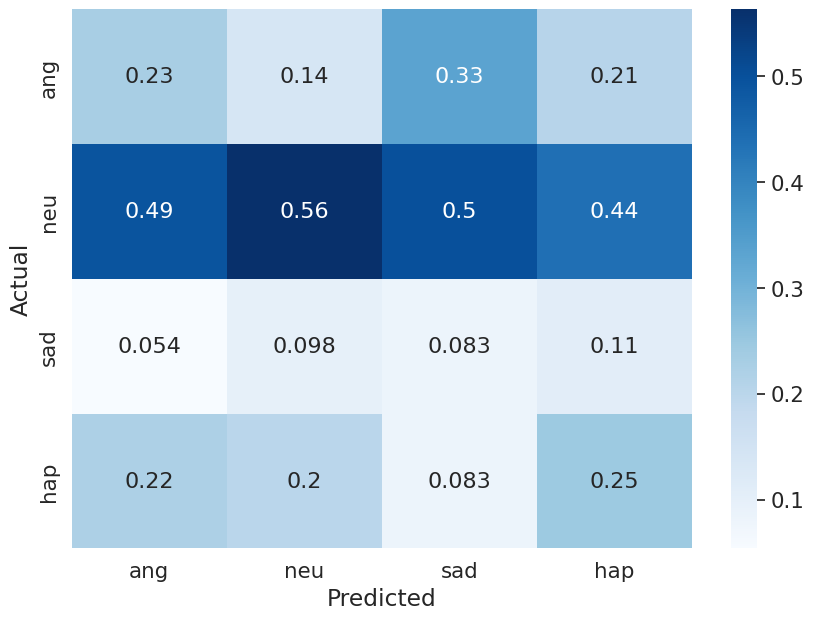

In [17]:
labels = dataset_config.target_labels
a = cm
# a /= reduce(a, 'y yh -> y 1', 'sum')
a = a / reduce(a, 'y yh -> 1 yh', 'sum')
df_cm = pd.DataFrame(a, columns=labels, index = labels )
df_cm.index.name = 'Actual'
df_cm.columns.name = 'Predicted'
plt.figure(figsize = (10,7))
sns.set(font_scale=1.4) #for label size
sns.heatmap(
    df_cm, cmap="Blues", 
    annot=True,
    annot_kws={"size": 16})# font size

<Axes: xlabel='Predicted', ylabel='Actual'>

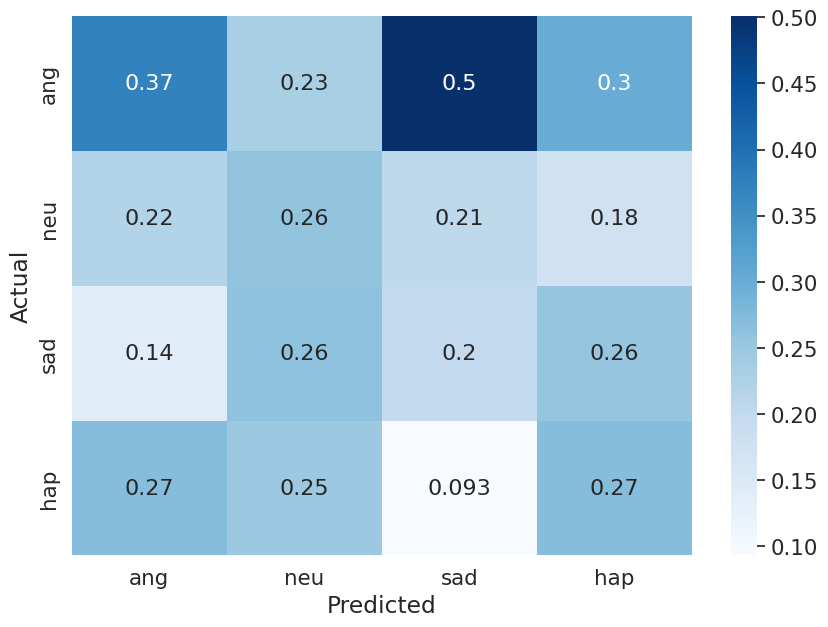

In [18]:
a = cm
a = a / reduce(a, 'y yh -> y 1', 'sum')
a = a / reduce(a, 'y yh -> 1 yh', 'sum')
df_cm = pd.DataFrame(a, columns=labels, index = labels )
df_cm.index.name = 'Actual'
df_cm.columns.name = 'Predicted'
plt.figure(figsize = (10,7))
sns.set(font_scale=1.4) #for label size
sns.heatmap(
    df_cm, cmap="Blues", 
    annot=True,
    annot_kws={"size": 16})# font size

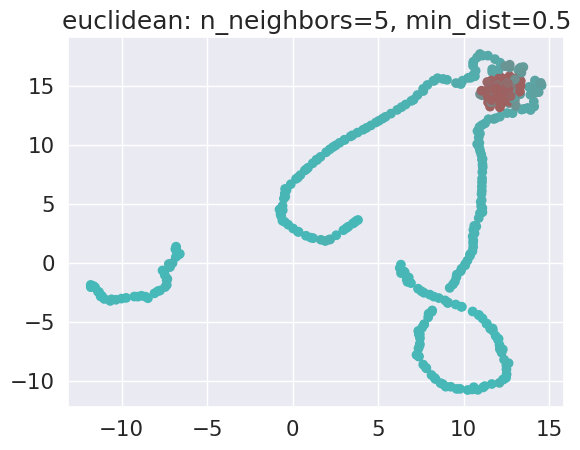

In [19]:
emb = model.embedding_filters.data.cpu()
emb_color, zcs = get_embedding_color_v2(emb)
k = 5
min_dist = 0.5
umap_metric = 'euclidean'
visualize_embedding_umap(emb, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

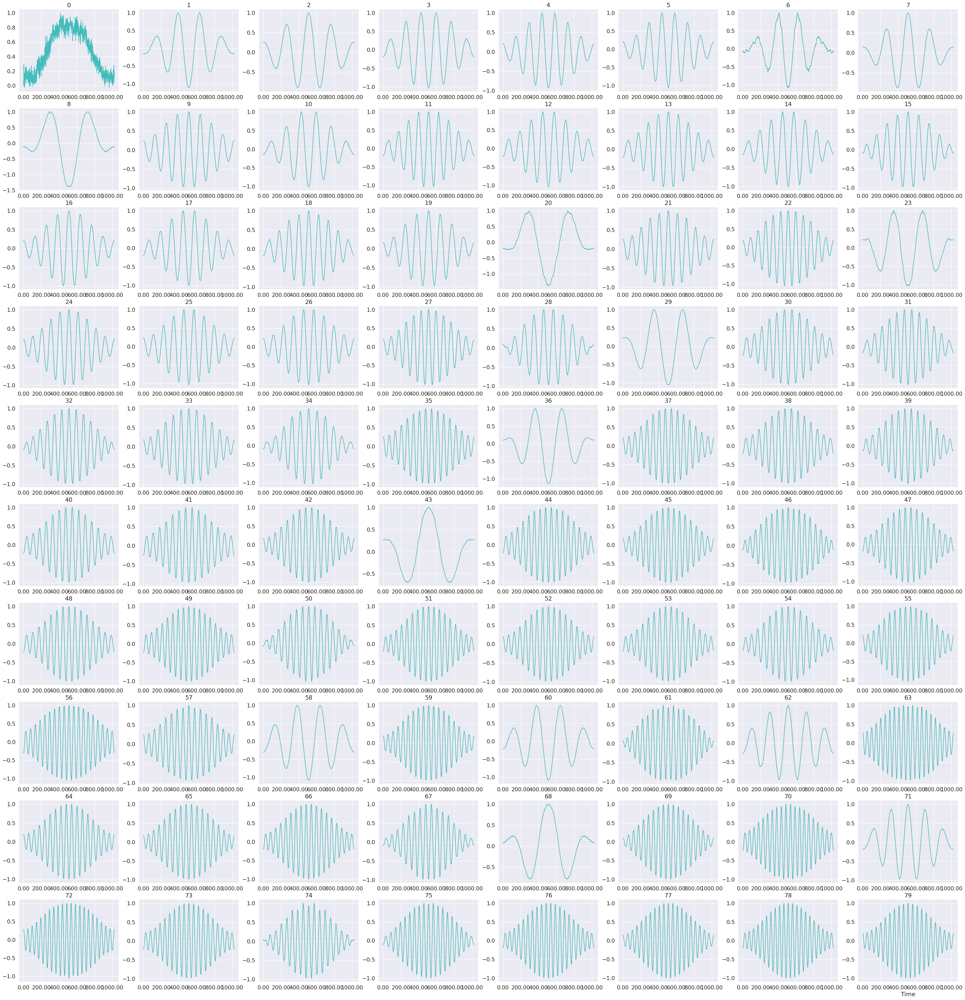

In [20]:
selected_emb_topk = torch.topk(zcs, 80)
selected_idx = selected_emb_topk.indices[-80:]
visualize_speech_codebook(
    emb[selected_idx].numpy(), 
    n=80, colors=emb_color[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

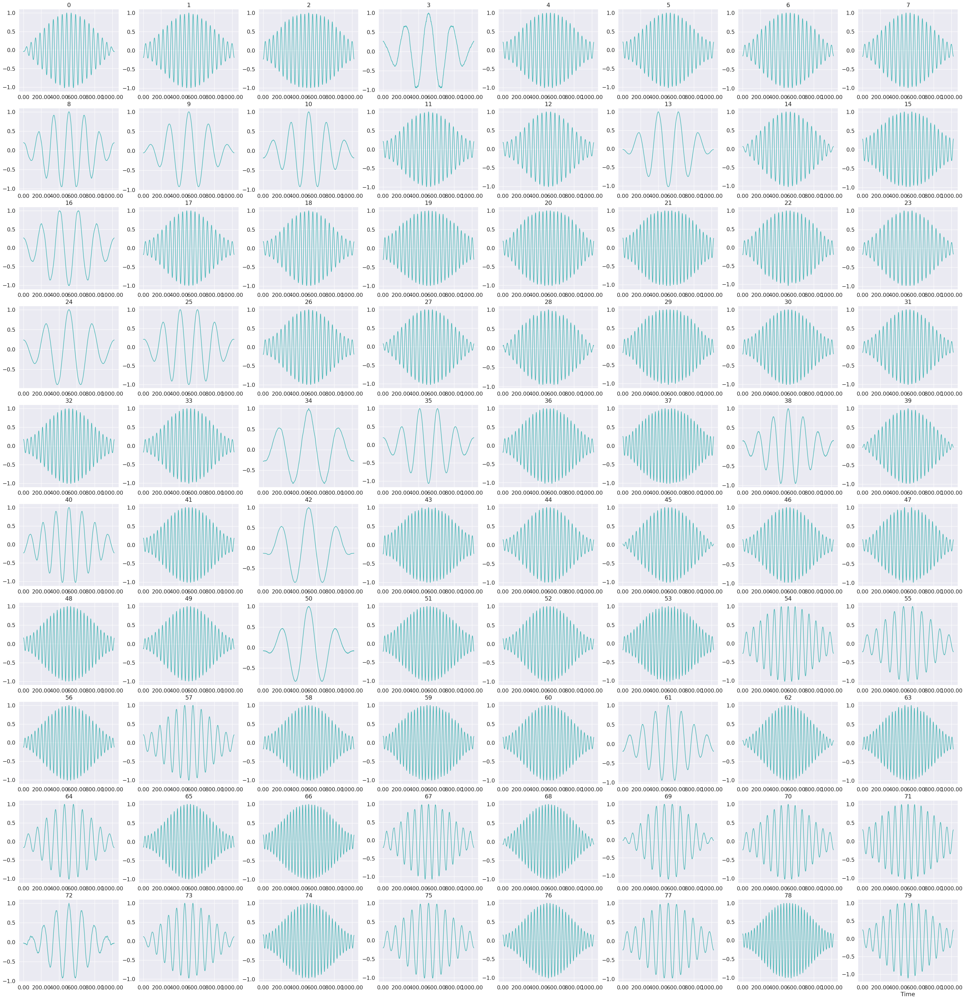

In [21]:
selected_emb_topk = torch.topk(zcs, 160)
selected_idx = selected_emb_topk.indices[-80:]
visualize_speech_codebook(
    emb[selected_idx].numpy(), 
    n=80, colors=emb_color[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

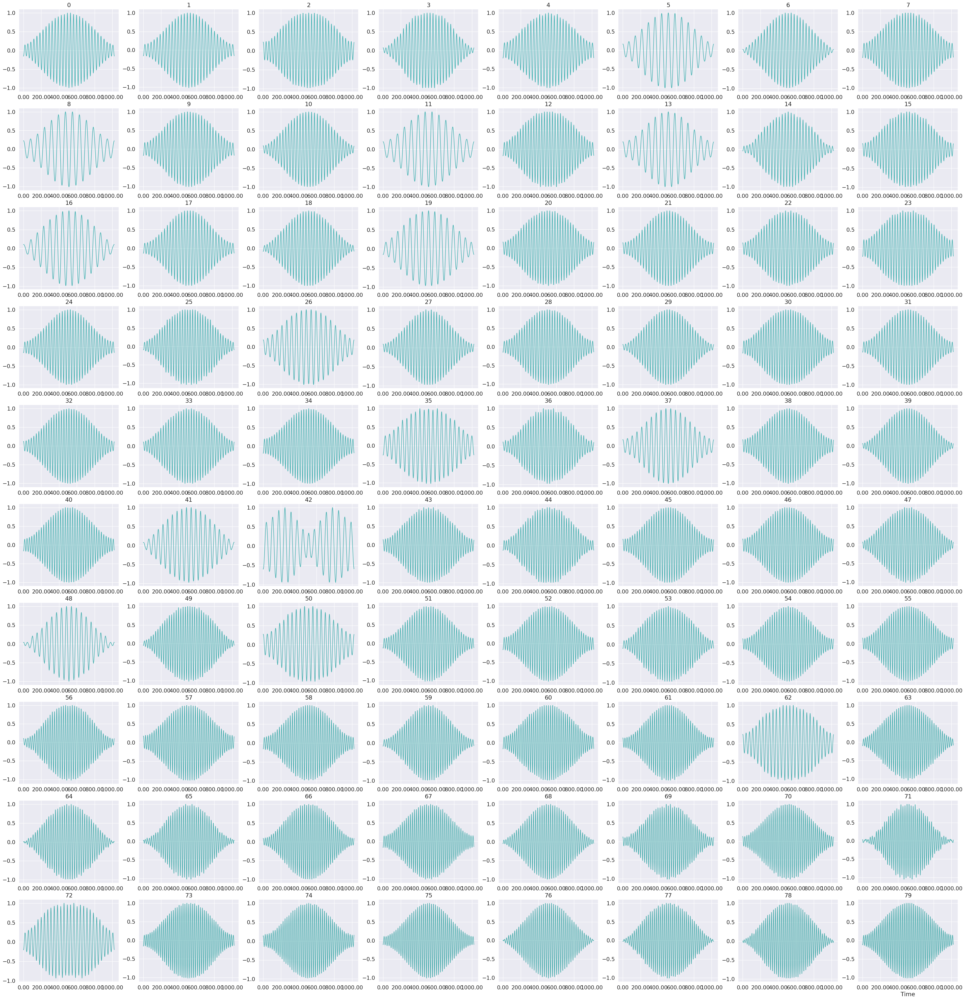

In [22]:
selected_emb_topk = torch.topk(zcs, 240)
selected_idx = selected_emb_topk.indices[-80:]
visualize_speech_codebook(
    emb[selected_idx].numpy(), 
    n=80, colors=emb_color[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

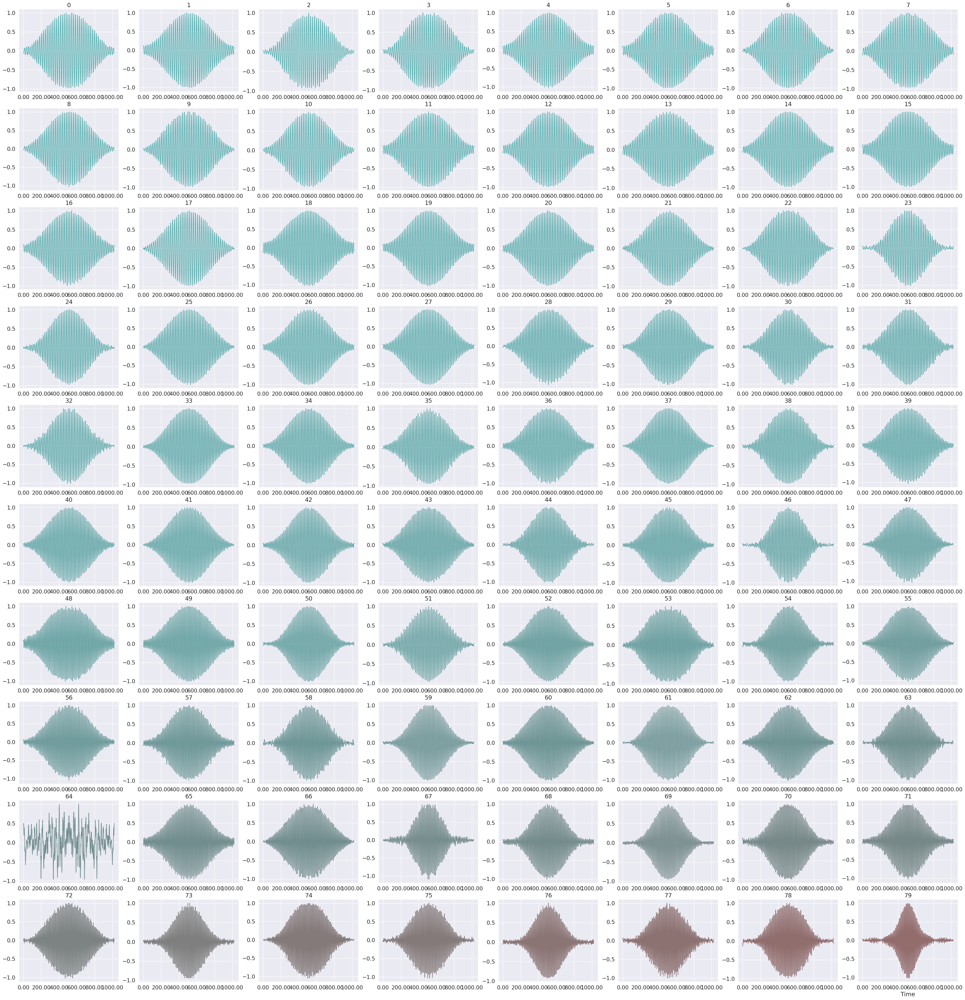

In [23]:
selected_emb_topk = torch.topk(zcs, 320)
selected_idx = selected_emb_topk.indices[-80:]
visualize_speech_codebook(
    emb[selected_idx].numpy(), 
    n=80, colors=emb_color[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

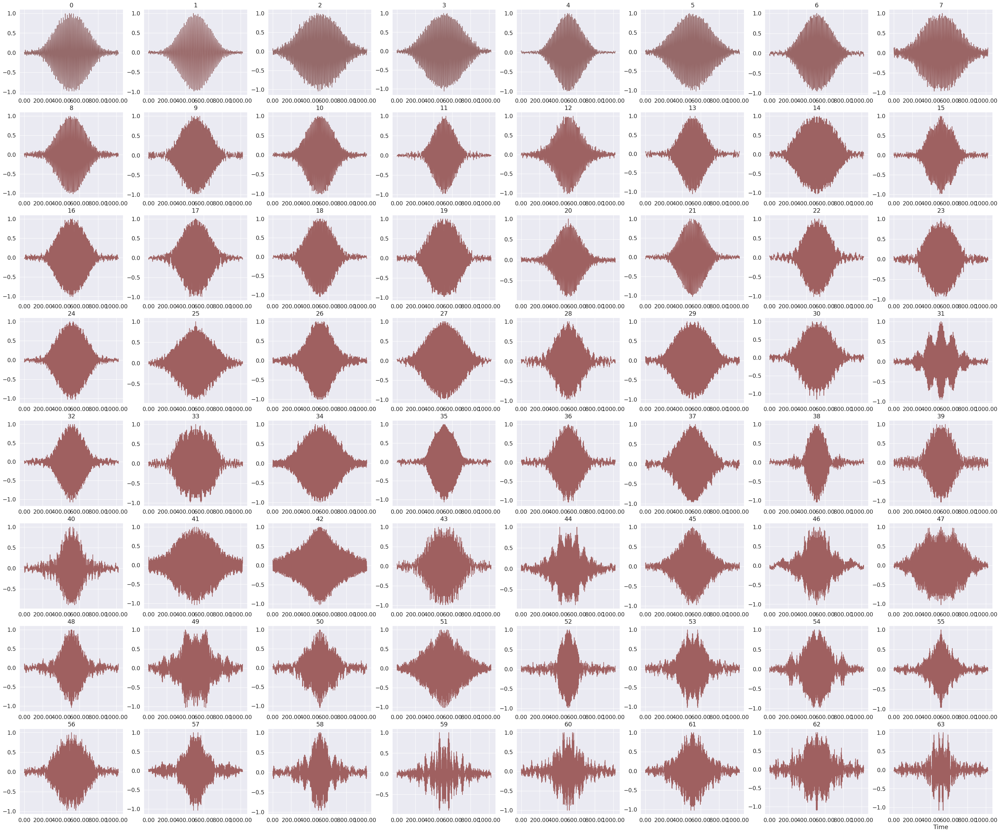

In [24]:
selected_emb_topk = torch.topk(zcs, 384)
selected_idx = selected_emb_topk.indices[-64:]
visualize_speech_codebook(
    emb[selected_idx].numpy(), 
    n=64, colors=emb_color[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

In [25]:
suffix = f"epoch={trainer.current_epoch}.step={trainer.current_step}.test.UA=0.268.UF1=0.238.pt"
checkpoint_path = f"{trainer.log_dir}model.{suffix}"
print(checkpoint_path)

../scb7_models/meld/model.epoch=75.step=191170.test.UA=0.268.UF1=0.238.pt


In [26]:
trainer.save(checkpoint_path)

In [33]:
torch.save(emb, log_dir + 'codebook.epoch=75.pt')

In [27]:
trainer.load_best_model(val_model=True)

Loaded: ../scb7_models/meld/model.epoch=28.step=70098.loss=8.680.val_acc=0.609.pt


In [28]:
metrics2, metrics_details2, confusion_matrix2 = trainer.test_step()

Correct: 914/1700 (0.5376)


In [29]:
me2 = metrics2.cpu().compute()
med2 = metrics_details2.cpu().compute()
cm2 = confusion_matrix2.cpu().compute()

In [30]:
pprint(me2)
pprint(med2)
pprint(cm2)

{'acc_unweighted': tensor(0.2834),
 'acc_weighted': tensor(0.5376),
 'f1s_unweighted': tensor(0.2524),
 'f1s_weighted': tensor(0.4359),
 'rocauc': tensor(0.5528),
 'uar': tensor(0.2834),
 'wap': tensor(0.4244)}
{'acc_detail': tensor([0.1751, 0.9093, 0.0000, 0.0493]),
 'f1s_detail': tensor([0.2273, 0.6972, 0.0000, 0.0852]),
 'precision_detail': tensor([0.3237, 0.5654, 0.0000, 0.3148]),
 'recall_detail': tensor([0.1751, 0.9093, 0.0000, 0.0493]),
 'rocauc_detail': tensor([0.6051, 0.5534, 0.5350, 0.5178])}
tensor([[ 45, 207,   0,   5],
        [ 55, 852,   0,  30],
        [ 12, 147,   0,   2],
        [ 27, 301,   0,  17]])


<Axes: xlabel='Predicted', ylabel='Actual'>

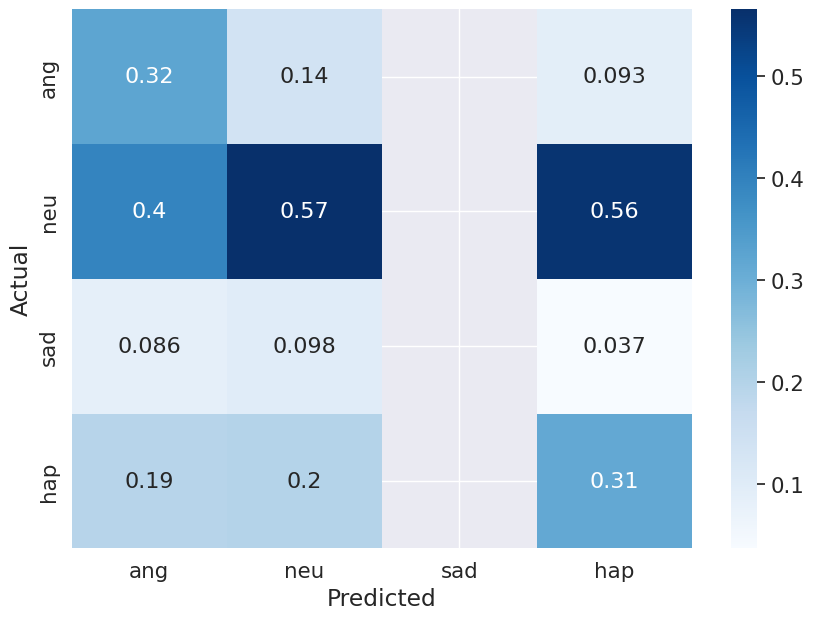

In [31]:
labels = dataset_config.target_labels
a = cm2
# a /= reduce(a, 'y yh -> y 1', 'sum')
a = a / reduce(a, 'y yh -> 1 yh', 'sum')
df_cm = pd.DataFrame(a, columns=labels, index = labels )
df_cm.index.name = 'Actual'
df_cm.columns.name = 'Predicted'
plt.figure(figsize = (10,7))
sns.set(font_scale=1.4) #for label size
sns.heatmap(
    df_cm, cmap="Blues", 
    annot=True,
    annot_kws={"size": 16})# font size

<Axes: xlabel='Predicted', ylabel='Actual'>

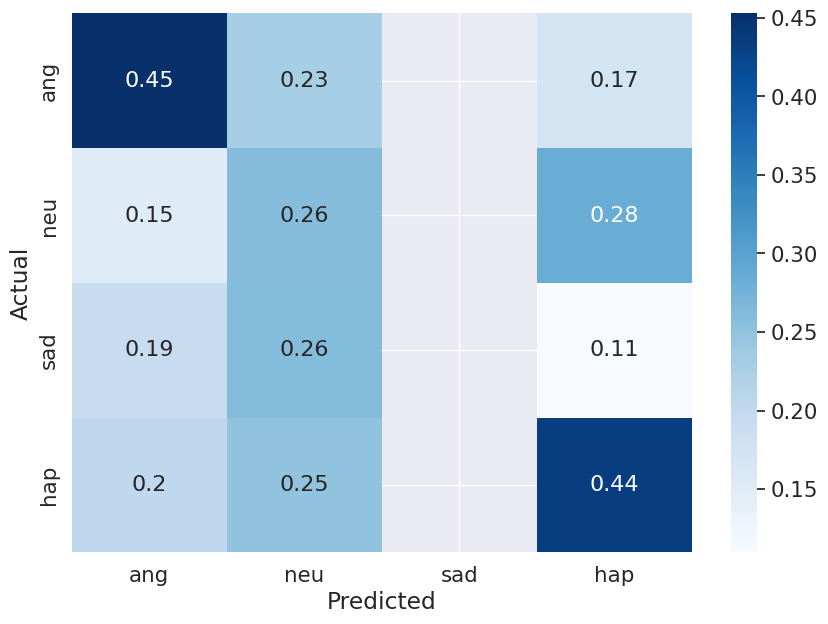

In [32]:
a = cm2
a = a / reduce(a, 'y yh -> y 1', 'sum')
a = a / reduce(a, 'y yh -> 1 yh', 'sum')
df_cm = pd.DataFrame(a, columns=labels, index = labels )
df_cm.index.name = 'Actual'
df_cm.columns.name = 'Predicted'
plt.figure(figsize = (10,7))
sns.set(font_scale=1.4) #for label size
sns.heatmap(
    df_cm, cmap="Blues", 
    annot=True,
    annot_kws={"size": 16})# font size

In [34]:
dt = []
for i, ld in enumerate(trainer.train_losses_detail):
    d = {'loss': trainer.train_losses[i]}
    for j, k in enumerate(ld._fields):
        d[k] = ld[j]
    dt.append(d)
loss_df2 = pd.DataFrame(dt)
loss_df2

,loss,perplexity,loss_vq,loss_recon,loss_cls
0,138.203049,9.944174,137.866623,0.119761,1.444424
1,75.493507,7.742599,75.174271,0.126076,1.287717
2,50.621204,6.871560,50.315590,0.103679,1.346225
3,85.336761,11.330937,84.991447,0.149518,1.305274
4,7.335482,7.999990,6.995987,0.130186,1.395395
...,...,...,...,...,...
191165,12.373133,3.794195,11.966705,0.184462,1.479771
191166,17.105659,4.263139,16.802919,0.161149,0.943934
191167,14.906224,6.575168,14.558252,0.178453,1.130122
191168,31.790586,13.454322,31.478111,0.197294,0.767878


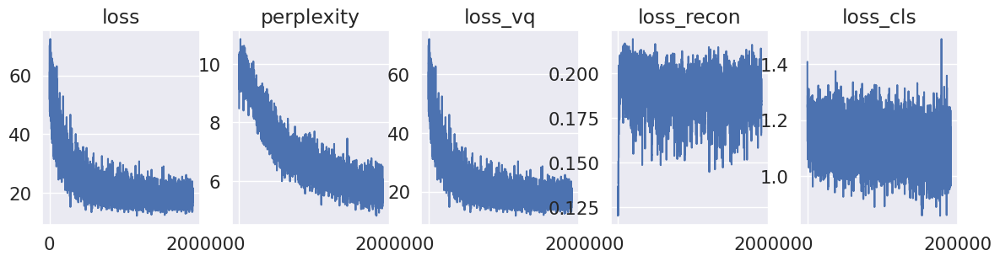

In [35]:
from scipy.signal import savgol_filter

fig, axes = plt.subplots(1, 5, figsize=(14,3))
for i, c in enumerate(loss_df2.columns):
    axes[i].plot(savgol_filter(loss_df2[c], 301, 7))
    axes[i].set_title(c)

Text(0.5, 1.0, 'Test accuracy per 10 epochs')

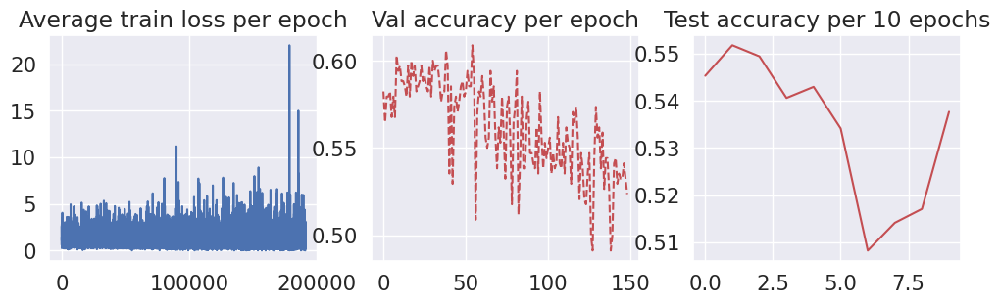

In [36]:
fig, axes = plt.subplots(1, 3, figsize=(12,3))
axes[0].plot(loss_df2['loss_cls'].values, color="b")
axes[0].set_title("Average train loss per epoch")
axes[1].plot(trainer.val_accuracy, color="r", linestyle="dashed")
axes[1].set_title("Val accuracy per epoch")
axes[2].plot(trainer.test_accuracy, color="r")
axes[2].set_title("Test accuracy per 10 epochs")

Text(0.5, 1.0, 'Test accuracy per 10 epochs')

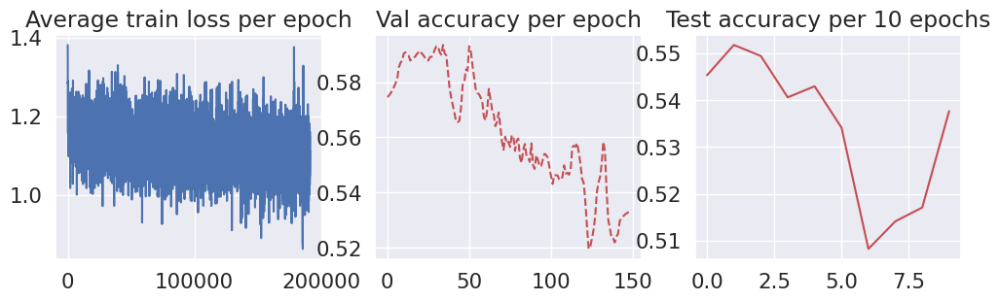

In [37]:
fig, axes = plt.subplots(1, 3, figsize=(12,3))
axes[0].plot(savgol_filter(loss_df2['loss_cls'].values, 301, 5), color="b")
axes[0].set_title("Average train loss per epoch")
axes[1].plot(savgol_filter(trainer.val_accuracy, 13, 2), color="r", linestyle="dashed")
axes[1].set_title("Val accuracy per epoch")
axes[2].plot(trainer.test_accuracy, color="r")
axes[2].set_title("Test accuracy per 10 epochs")

In [38]:
trained_epoch = trainer.current_epoch
n = len(trainer.train_losses)
trained_steps = n - (n % trained_epoch)
train_losses = reduce(np.array(
    trainer.train_losses[:trained_steps]), '(n k) -> n', 'mean', n=trained_epoch)
train_losses_cls = reduce(np.array(
    loss_df2['loss_cls'].values[:trained_steps]), '(n k) -> n', 'mean', n=trained_epoch)


Text(0.5, 1.0, 'Test accuracy per 10 epochs')

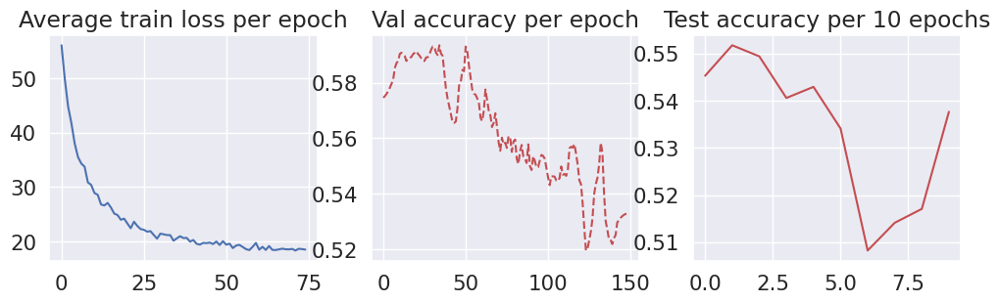

In [39]:
fig, axes = plt.subplots(1, 3, figsize=(12,3))
axes[0].plot(train_losses, color="b")
axes[0].set_title("Average train loss per epoch")
axes[1].plot(savgol_filter(trainer.val_accuracy, 13, 2), color="r", linestyle="dashed")
axes[1].set_title("Val accuracy per epoch")
axes[2].plot(trainer.test_accuracy, color="r")
axes[2].set_title("Test accuracy per 10 epochs")

Text(0.5, 1.0, 'Test accuracy per 10 epochs')

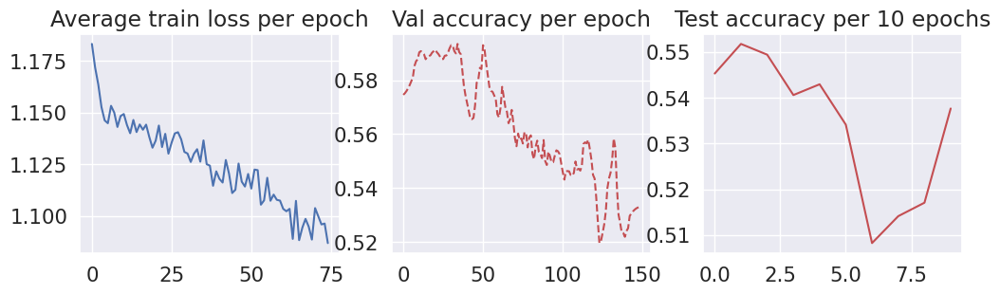

In [40]:
fig, axes = plt.subplots(1, 3, figsize=(12,3))
axes[0].plot(train_losses_cls, color="b")
axes[0].set_title("Average train loss per epoch")
axes[1].plot(savgol_filter(trainer.val_accuracy, 13, 2), color="r", linestyle="dashed")
axes[1].set_title("Val accuracy per epoch")
axes[2].plot(trainer.test_accuracy, color="r")
axes[2].set_title("Test accuracy per 10 epochs")

In [41]:
train_log = {
    'train_loss': torch.tensor(train_losses),
    'train_loss_cls': torch.tensor(train_losses_cls),
    'val_acc': torch.tensor(trainer.val_accuracy),
    'test_acc': torch.tensor(trainer.test_accuracy),
    'test_confusion_matrix': cm,
    'test_metrics': me,
    'test_metrics_detail': med,
    'best_model_path': checkpoint_path,
    'best_codebook_path': log_dir + 'codebook.epoch=75.pt'
}
torch.save(train_log, log_dir+"train_metrics.pt")

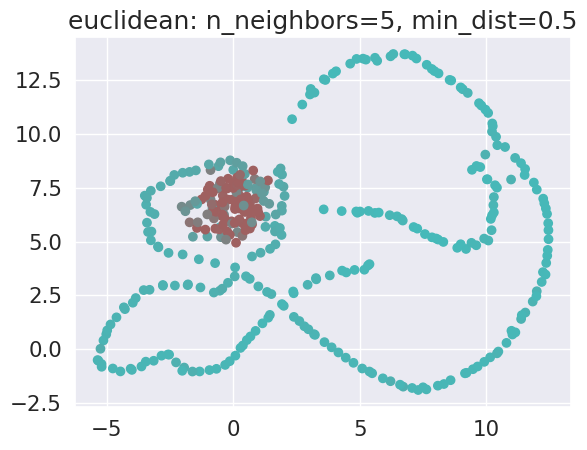

In [42]:
emb2 = model.embedding_filters.data.cpu()
emb_color2, zcs2 = get_embedding_color_v2(emb2)
k = 5
min_dist = 0.5
umap_metric = 'euclidean'
visualize_embedding_umap(emb2, colors=emb_color2, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

In [43]:
torch.save(emb2, log_dir + 'codebook.epoch=28.pt')

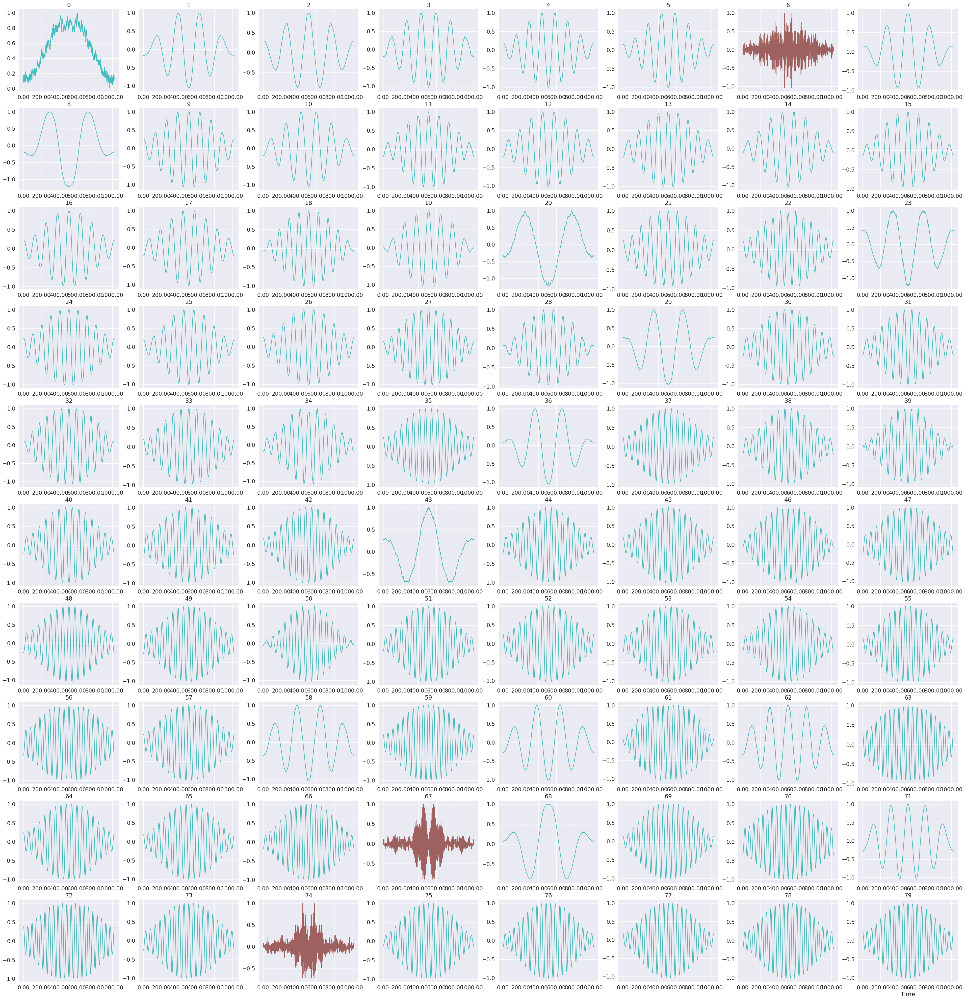

In [45]:
selected_emb_topk = torch.topk(zcs, 80)
selected_idx = selected_emb_topk.indices[-80:]
visualize_speech_codebook(
    emb2[selected_idx].numpy(), 
    n=80, colors=emb_color2[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

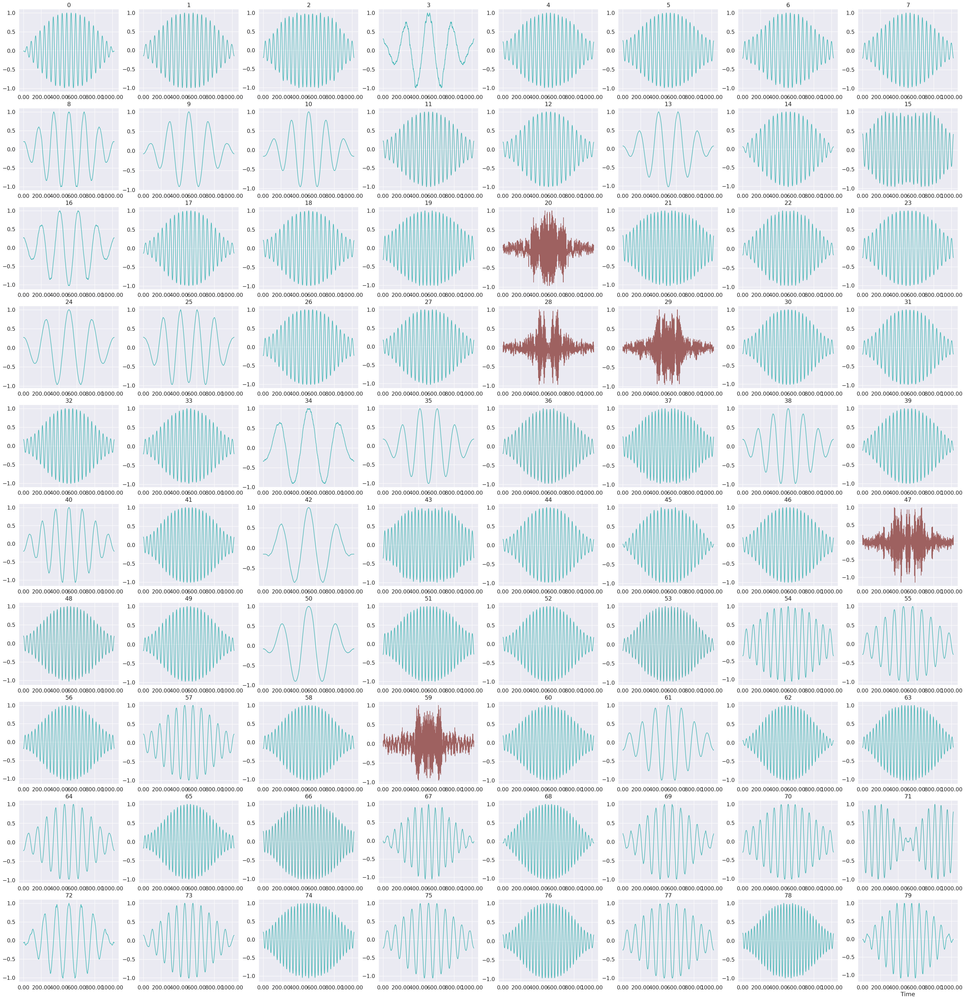

In [46]:
selected_emb_topk = torch.topk(zcs, 160)
selected_idx = selected_emb_topk.indices[-80:]
visualize_speech_codebook(
    emb2[selected_idx].numpy(), 
    n=80, colors=emb_color2[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

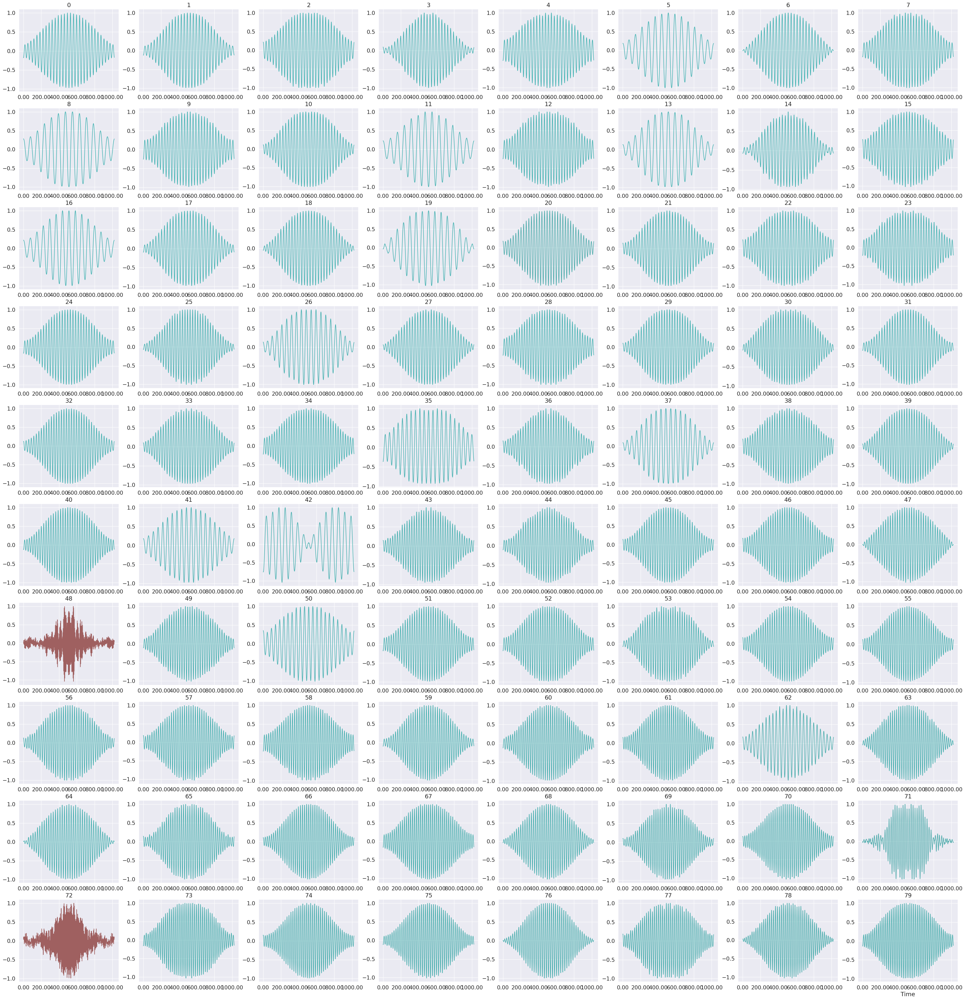

In [47]:
selected_emb_topk = torch.topk(zcs, 240)
selected_idx = selected_emb_topk.indices[-80:]
visualize_speech_codebook(
    emb2[selected_idx].numpy(), 
    n=80, colors=emb_color2[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

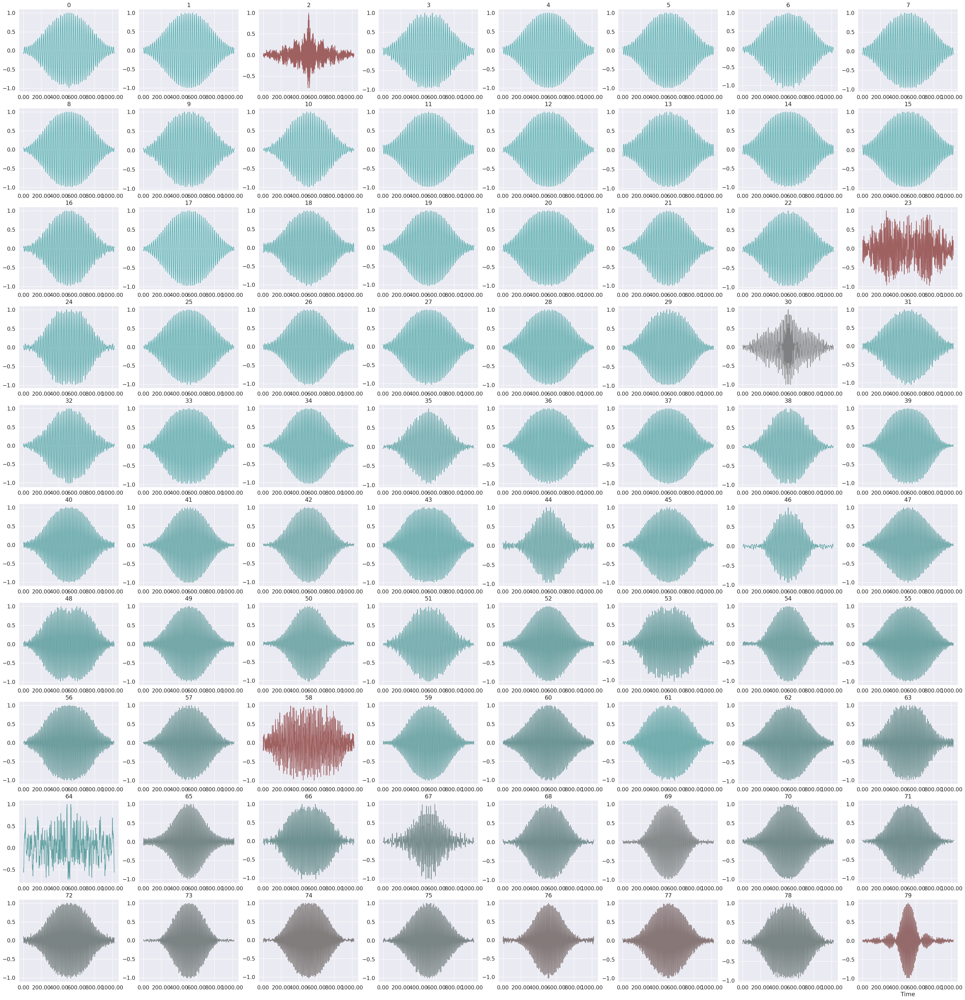

In [48]:
selected_emb_topk = torch.topk(zcs, 320)
selected_idx = selected_emb_topk.indices[-80:]
visualize_speech_codebook(
    emb2[selected_idx].numpy(), 
    n=80, colors=emb_color2[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

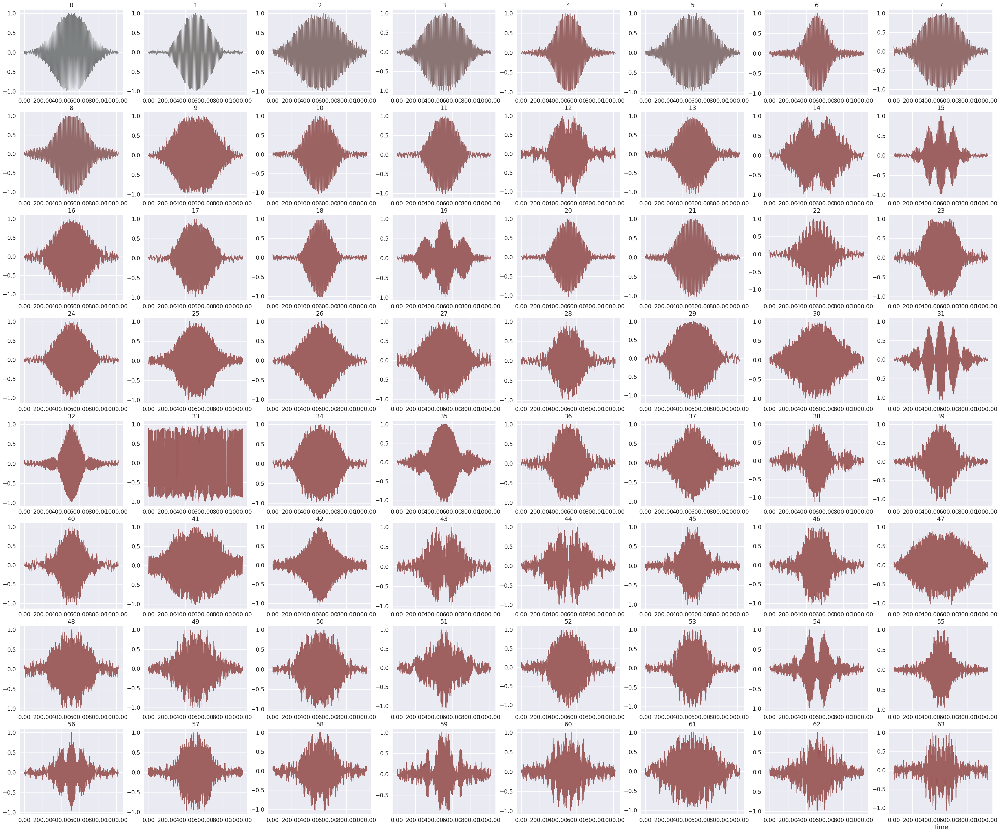

In [49]:
selected_emb_topk = torch.topk(zcs, 384)
selected_idx = selected_emb_topk.indices[-64:]
visualize_speech_codebook(
    emb2[selected_idx].numpy(), 
    n=64, colors=emb_color2[selected_idx], 
    feature_mel=False, waveplot_librosa=False)